### Import Library

In [2]:
import pandas as pd
pd.set_option('display.max_columns',500)
pd.set_option('display.max_rows',100)
import warnings
warnings.filterwarnings("ignore")
from datetime import datetime,timedelta
import datetime as dat,numpy as np,seaborn as sns,matplotlib.pyplot as plt
import math
from sklearn.metrics import confusion_matrix,accuracy_score
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE
import scipy
from scipy import spatial
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.linear_model import LogisticRegression 
from sklearn.model_selection import KFold
from scipy import stats
from catboost import CatBoostClassifier, Pool

In [3]:
def preprocess(csvfile):
    df = pd.read_csv(csvfile)
    labels = df['hospital_death'].tolist()
    #df = df.fillna(-999)
    #df = df.drop(['encounter_id', 'patient_id', 'hospital_death', 'readmission_status'], axis=1)
    return df, labels

### Load data

In [4]:
train_features, train_labels = preprocess('training_v2.csv')
test_features, _ = preprocess('unlabeled.csv')
wids_dic = pd.read_csv('WiDS Datathon 2020 Dictionary.csv')

### Explore data

In [5]:
train_features.head(1)

,encounter_id,patient_id,hospital_id,hospital_death,age,bmi,elective_surgery,ethnicity,gender,height,hospital_admit_source,icu_admit_source,icu_id,icu_stay_type,icu_type,pre_icu_los_days,readmission_status,weight,albumin_apache,apache_2_diagnosis,apache_3j_diagnosis,apache_post_operative,arf_apache,bilirubin_apache,bun_apache,creatinine_apache,fio2_apache,gcs_eyes_apache,gcs_motor_apache,gcs_unable_apache,gcs_verbal_apache,glucose_apache,heart_rate_apache,hematocrit_apache,intubated_apache,map_apache,paco2_apache,paco2_for_ph_apache,pao2_apache,ph_apache,resprate_apache,sodium_apache,temp_apache,urineoutput_apache,ventilated_apache,wbc_apache,d1_diasbp_invasive_max,d1_diasbp_invasive_min,d1_diasbp_max,d1_diasbp_min,d1_diasbp_noninvasive_max,d1_diasbp_noninvasive_min,d1_heartrate_max,d1_heartrate_min,d1_mbp_invasive_max,d1_mbp_invasive_min,d1_mbp_max,d1_mbp_min,d1_mbp_noninvasive_max,d1_mbp_noninvasive_min,d1_resprate_max,d1_resprate_min,d1_spo2_max,d1_spo2_min,d1_sysbp_invasive_max,d1_sysbp_invasive_min,d1_sysbp_max,d1_sysbp_min,d1_sysbp_noninvasive_max,d1_sysbp_noninvasive_min,d1_temp_max,d1_temp_min,h1_diasbp_invasive_max,h1_diasbp_invasive_min,h1_diasbp_max,h1_diasbp_min,h1_diasbp_noninvasive_max,h1_diasbp_noninvasive_min,h1_heartrate_max,h1_heartrate_min,h1_mbp_invasive_max,h1_mbp_invasive_min,h1_mbp_max,h1_mbp_min,h1_mbp_noninvasive_max,h1_mbp_noninvasive_min,h1_resprate_max,h1_resprate_min,h1_spo2_max,h1_spo2_min,h1_sysbp_invasive_max,h1_sysbp_invasive_min,h1_sysbp_max,h1_sysbp_min,h1_sysbp_noninvasive_max,h1_sysbp_noninvasive_min,h1_temp_max,h1_temp_min,d1_albumin_max,d1_albumin_min,d1_bilirubin_max,d1_bilirubin_min,d1_bun_max,d1_bun_min,d1_calcium_max,d1_calcium_min,d1_creatinine_max,d1_creatinine_min,d1_glucose_max,d1_glucose_min,d1_hco3_max,d1_hco3_min,d1_hemaglobin_max,d1_hemaglobin_min,d1_hematocrit_max,d1_hematocrit_min,d1_inr_max,d1_inr_min,d1_lactate_max,d1_lactate_min,d1_platelets_max,d1_platelets_min,d1_potassium_max,d1_potassium_min,d1_sodium_max,d1_sodium_min,d1_wbc_max,d1_wbc_min,h1_albumin_max,h1_albumin_min,h1_bilirubin_max,h1_bilirubin_min,h1_bun_max,h1_bun_min,h1_calcium_max,h1_calcium_min,h1_creatinine_max,h1_creatinine_min,h1_glucose_max,h1_glucose_min,h1_hco3_max,h1_hco3_min,h1_hemaglobin_max,h1_hemaglobin_min,h1_hematocrit_max,h1_hematocrit_min,h1_inr_max,h1_inr_min,h1_lactate_max,h1_lactate_min,h1_platelets_max,h1_platelets_min,h1_potassium_max,h1_potassium_min,h1_sodium_max,h1_sodium_min,h1_wbc_max,h1_wbc_min,d1_arterial_pco2_max,d1_arterial_pco2_min,d1_arterial_ph_max,d1_arterial_ph_min,d1_arterial_po2_max,d1_arterial_po2_min,d1_pao2fio2ratio_max,d1_pao2fio2ratio_min,h1_arterial_pco2_max,h1_arterial_pco2_min,h1_arterial_ph_max,h1_arterial_ph_min,h1_arterial_po2_max,h1_arterial_po2_min,h1_pao2fio2ratio_max,h1_pao2fio2ratio_min,apache_4a_hospital_death_prob,apache_4a_icu_death_prob,aids,cirrhosis,diabetes_mellitus,hepatic_failure,immunosuppression,leukemia,lymphoma,solid_tumor_with_metastasis,apache_3j_bodysystem,apache_2_bodysystem
0,66154,25312,118,0,68.0,22.73,0,Caucasian,M,180.3,Floor,Floor,92,admit,CTICU,0.541667,0,73.9,2.3,113.0,502.01,0,0.0,0.4,31.0,2.51,NaN,3.0,6.0,0.0,4.0,168.0,118.0,27.4,0.0,40.0,NaN,NaN,NaN,NaN,36.0,134.0,39.3,NaN,0.0,14.1,46.0,32.0,68.0,37.0,68.0,37.0,119.0,72.0,66.0,40.0,89.0,46.0,89.0,46.0,34.0,10.0,100.0,74.0,122.0,64.0,131.0,73.0,131.0,73.0,39.9,37.2,NaN,NaN,68.0,63.0,68.0,63.0,119.0,108.0,NaN,NaN,86.0,85.0,86.0,85.0,26.0,18.0,100.0,74.0,NaN,NaN,131.0,115.0,131.0,115.0,39.5,37.5,2.3,2.3,0.4,0.4,31.0,30.0,8.5,7.4,2.51,2.23,168.0,109.0,19.0,15.0,8.9,8.9,27.4,27.4,NaN,NaN,1.3,1.0,233.0,233.0,4.0,3.4,136.0,134.0,14.1,14.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.1,0.05,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,Sepsis,Cardiovascular


Imbalance dataset

In [6]:
train_features['hospital_death'].value_counts()

0    83798
1     7915
Name: hospital_death, dtype: int64

In [7]:
def find_unique_values(column_name):
    return column_name.unique()

Checking category column values

In [8]:
for i in train_features.columns:
    if train_features[i].dtype=='O':
        print("Colum name: "+ i)
        print("Unique Values: " + str(find_unique_values(train_features[i])))

Colum name: ethnicity
Unique Values: ['Caucasian' nan 'Hispanic' 'African American' 'Asian' 'Native American'
 'Other/Unknown']
Colum name: gender
Unique Values: ['M' 'F' nan]
Colum name: hospital_admit_source
Unique Values: ['Floor' 'Emergency Department' 'Operating Room' nan 'Direct Admit'
 'Other Hospital' 'Other ICU' 'ICU to SDU' 'Recovery Room'
 'Chest Pain Center' 'Step-Down Unit (SDU)' 'Acute Care/Floor' 'PACU'
 'Observation' 'ICU' 'Other']
Colum name: icu_admit_source
Unique Values: ['Floor' 'Accident & Emergency' 'Operating Room / Recovery'
 'Other Hospital' 'Other ICU' nan]
Colum name: icu_stay_type
Unique Values: ['admit' 'readmit' 'transfer']
Colum name: icu_type
Unique Values: ['CTICU' 'Med-Surg ICU' 'CCU-CTICU' 'Neuro ICU' 'MICU' 'SICU'
 'Cardiac ICU' 'CSICU']
Colum name: apache_3j_bodysystem
Unique Values: ['Sepsis' 'Respiratory' 'Metabolic' 'Cardiovascular' 'Trauma'
 'Neurological' 'Gastrointestinal' 'Genitourinary' nan 'Hematological'
 'Musculoskeletal/Skin' 'Gynecolog

To find the columns with missing values and percentage of missing values

In [9]:
def find_percentage_mising_values(data):
    missing_df = data.isnull().sum(axis=0).reset_index()
    missing_df.columns = ['column_name', 'missing_count']
    missing_df = missing_df.loc[missing_df['missing_count']>0]
    missing_df['missing_per'] = missing_df['missing_count']/len(data)
    return missing_df

In [10]:
missing_df = find_percentage_mising_values(train_features)

In [11]:
missing_df[missing_df['missing_per']>=0.9]

,column_name,missing_count,missing_per
128,h1_albumin_max,83824,0.913982
129,h1_albumin_min,83824,0.913982
130,h1_bilirubin_max,84619,0.922650
131,h1_bilirubin_min,84619,0.922650
148,h1_lactate_max,84369,0.919924
149,h1_lactate_min,84369,0.919924


Most of the missing values are either 'min' or 'max' named columns.                                                      
Columns which are not min or max -                                                                     paco2_for_ph_apache, pao2_apache, ph_apache, paco2_apache, fio2_apache, bilirubin_apache, albumin_apache, urineoutput_apache, wbc_apache, hospital_admit_source, hematocrit_apache, bun_apache, creatinine_apache, sodium_apache, glucose_apache, apache_4a_hospital_death_prob, apache_4a_hospital_death_prob, age, bmi, weight, gcs_verbal_apache, gcs_motor_apache, gcs_eyes_apache, apache_3j_bodysystem, apache_2_bodysystem, apache_2_diagnosis, ethnicity, height, resprate_apache, apache_3j_diagnosis, gcs_unable_apache, map_apache, heart_rate_apache, leukemia, immunosuppression, hepatic_failure, ventilated_apache,
diabetes_mellitus, cirrhosis, intubated_apache, aids, arf_apache, lymphoma, icu_admit_source, gender

Few facts to be checked:
    1. Age could be a criteria for division amongst people
    2. icu_stay_type- readmit could result in higher deaths
    3. If gcs_verbal_apache is 1, then higher are chances of resulting in hospital_death
    4. if gcs_eyes_apache is 1, then higher are chances of resulting in hospital_death
    5. The data comprises majority of Caucasian ethinicity
    6. If ventilated_apache is 1, higher chances of resulting in hospital_death

In [12]:
def plot_missing_values_graph(data,column_name):
    plt.subplot(1, 2, 1)
    data[(data[column_name].isnull()==False)&(data['hospital_death']==0)][column_name].hist()
    plt.title('Percentage Hospital_death is 0')
    plt.subplot(1, 2, 2)
    plt.title('Percentage Hospital_death is 1')
    data[(data[column_name].isnull()==False)&(data['hospital_death']==1)][column_name].hist()
    plt.show()

def plot_cat_missing_values_graph(data,column_name):
    plt.figure(figsize=(10,4))
    plt.subplot(1, 3, 1)
    temp = data[data[column_name].isnull()==False]
    plt.xticks(rotation='vertical')
    sns.countplot(data = temp,x = column_name)
    plt.title('CountPlot of '+ column_name)
    plt.subplot(1, 3, 2)
    temp = data[(data[column_name].isnull()==False)&(data['hospital_death']==0)]
    sns.barplot(data = temp,x = column_name,y='hospital_death',estimator=lambda x: len(x) / len(temp) * 100)
    plt.title('Percentage Hospital_death is 0')
    plt.xticks(rotation='vertical')
    plt.subplot(1, 3, 3)
    plt.title('Percentage Hospital_death is 1')
    temp = data[(data[column_name].isnull()==False)&(data['hospital_death']==1)]
    sns.barplot(data = temp,x = column_name,y='hospital_death',estimator=lambda x: len(x) / len(temp) * 100)
    plt.xticks(rotation='vertical')
    plt.show()

Numeric Columns with Missing Values without max and min columns

paco2_for_ph_apache


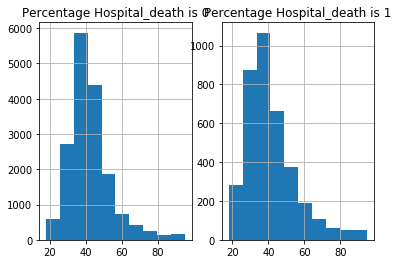

pao2_apache


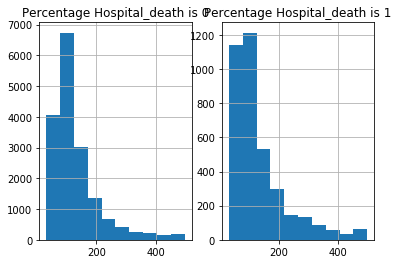

ph_apache


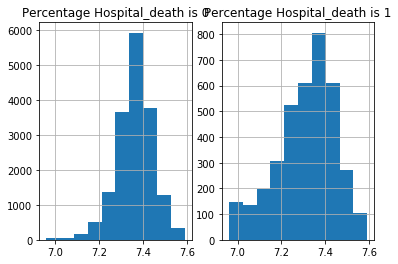

paco2_apache


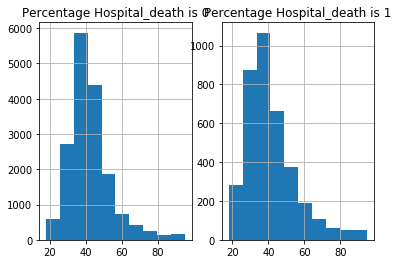

fio2_apache


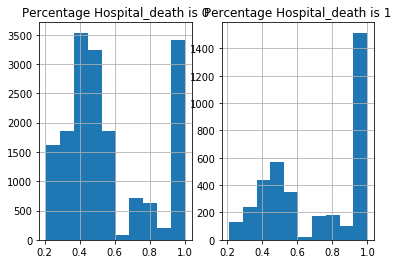

bilirubin_apache


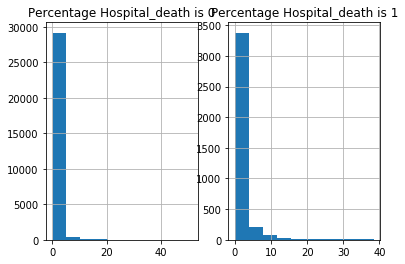

albumin_apache


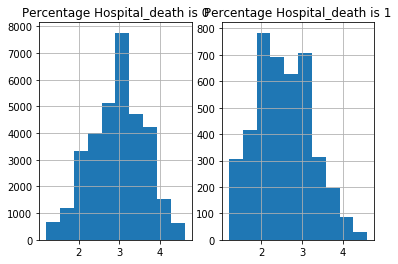

urineoutput_apache


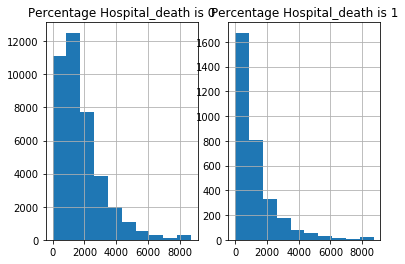

wbc_apache


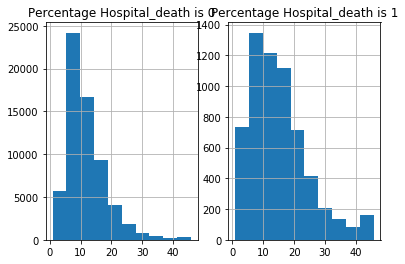

hematocrit_apache


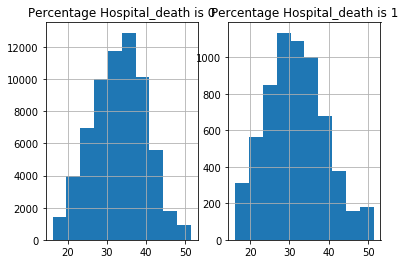

bun_apache


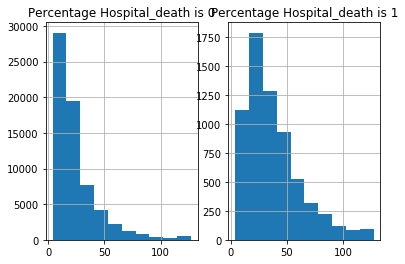

creatinine_apache


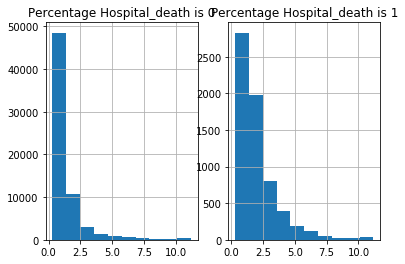

sodium_apache


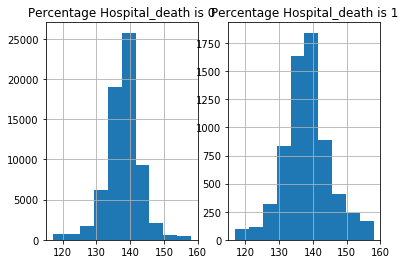

glucose_apache


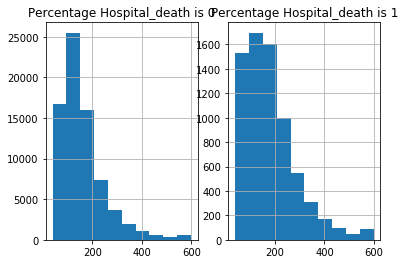

apache_4a_hospital_death_prob


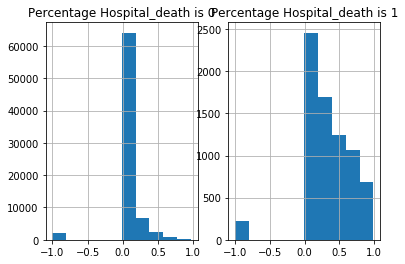

apache_4a_icu_death_prob


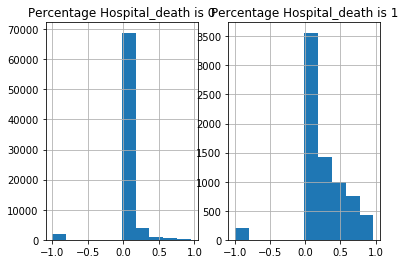

age


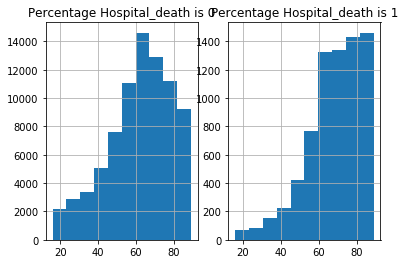

bmi


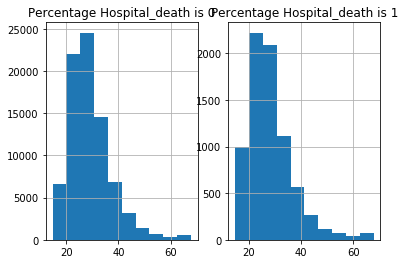

weight


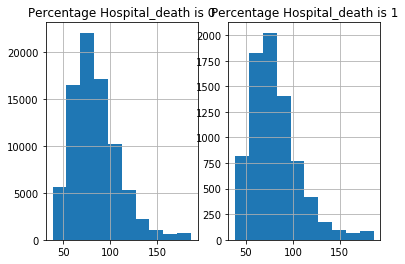

apache_2_diagnosis


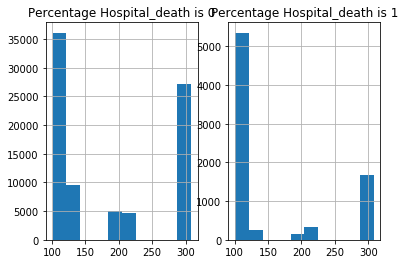

height


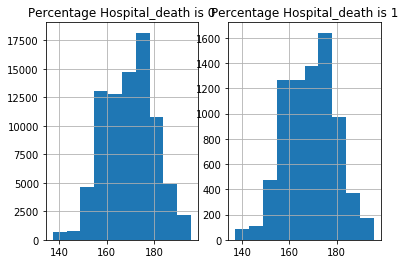

resprate_apache


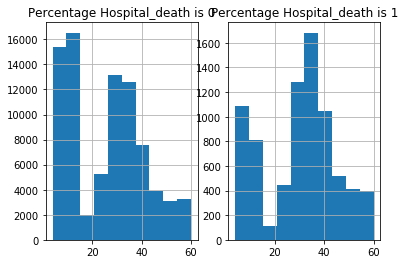

apache_3j_diagnosis


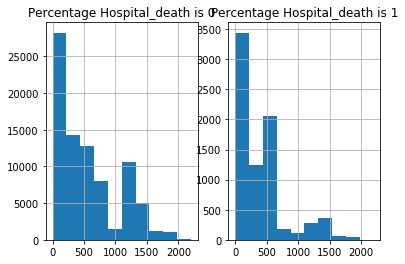

map_apache


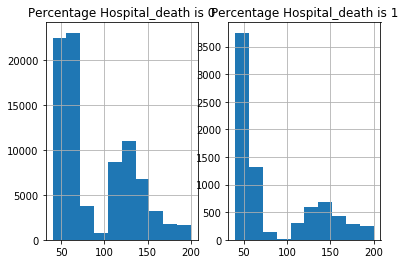

heart_rate_apache


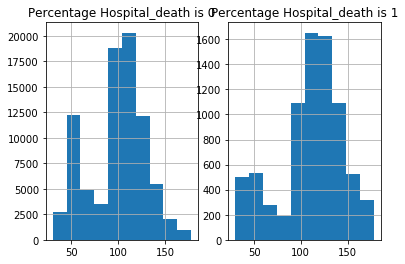

In [13]:
missing_num_cols_without_min_max = ['paco2_for_ph_apache','pao2_apache','ph_apache','paco2_apache','fio2_apache',\
                                'bilirubin_apache','albumin_apache','urineoutput_apache','wbc_apache','hematocrit_apache','bun_apache','creatinine_apache',\
                                'sodium_apache','glucose_apache','apache_4a_hospital_death_prob','apache_4a_icu_death_prob',\
                                'age','bmi','weight','apache_2_diagnosis',\
                                'height','resprate_apache','apache_3j_diagnosis','map_apache',\
                                'heart_rate_apache']
for i in missing_num_cols_without_min_max:
    print(i)
    plot_missing_values_graph(train_features,i)

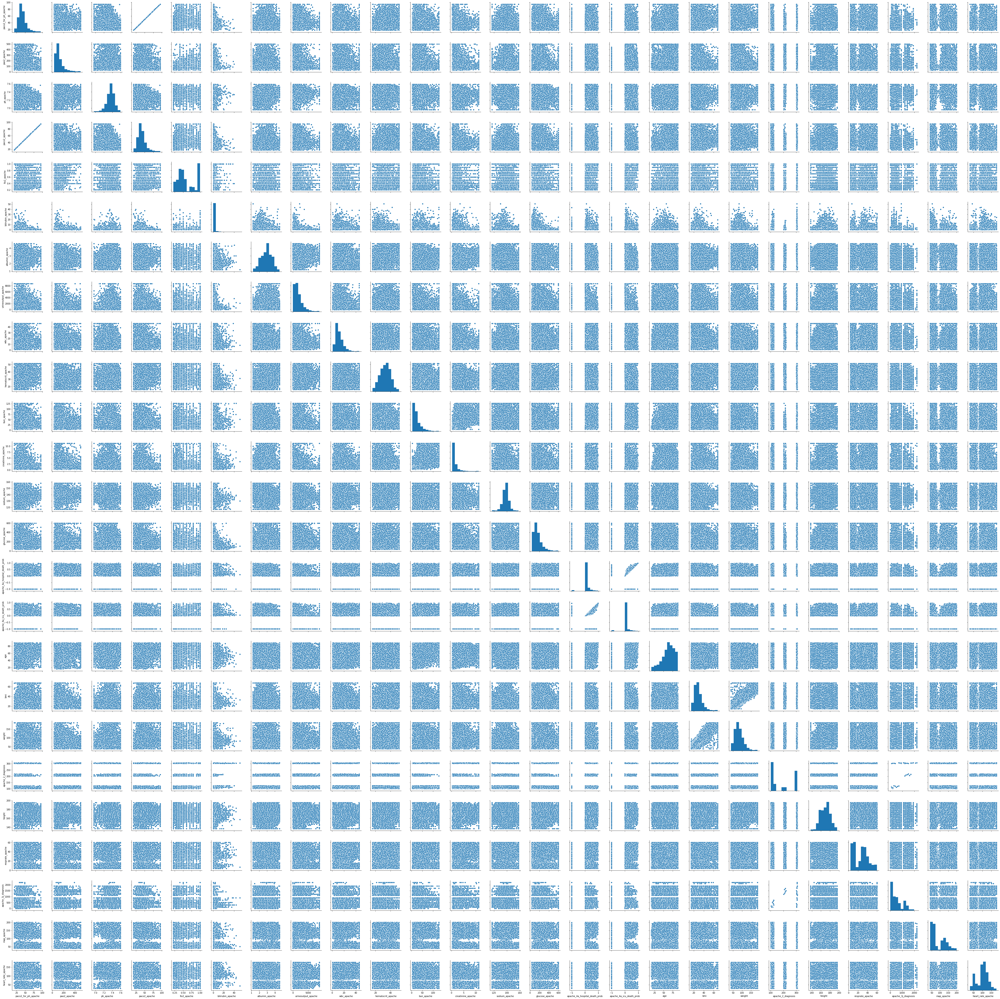

In [13]:
sns.pairplot(train_features[missing_num_cols_without_min_max])
plt.show()

Category columns with missing values

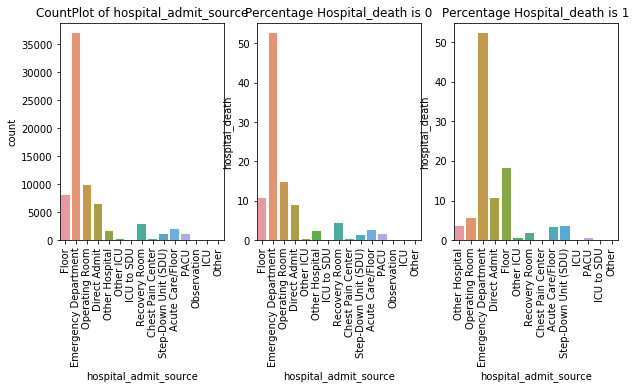

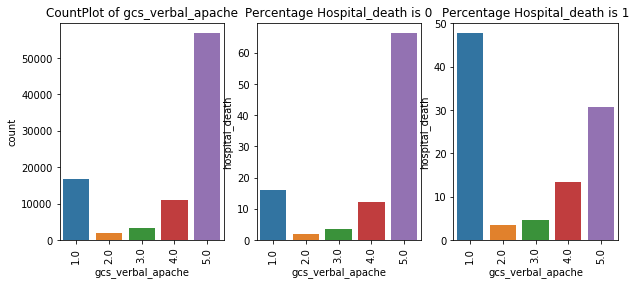

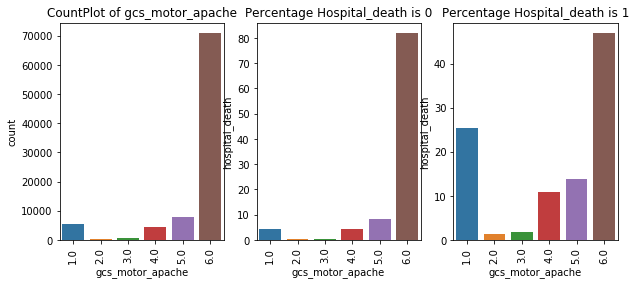

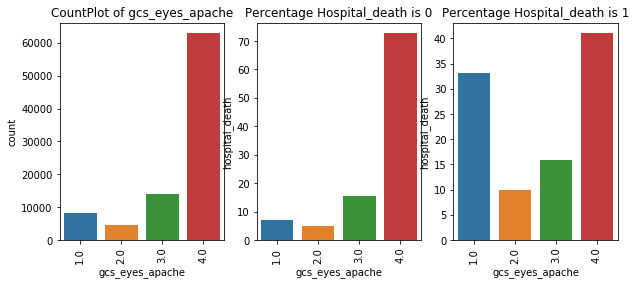

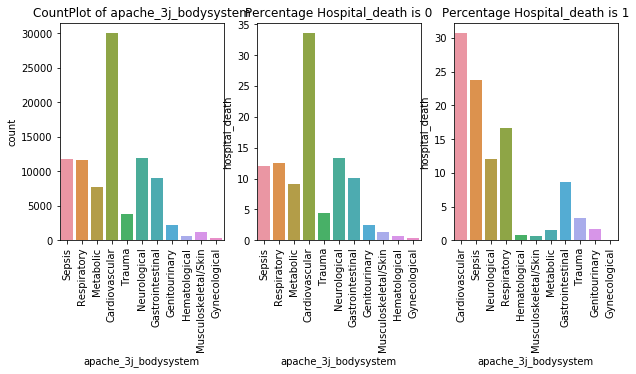

...

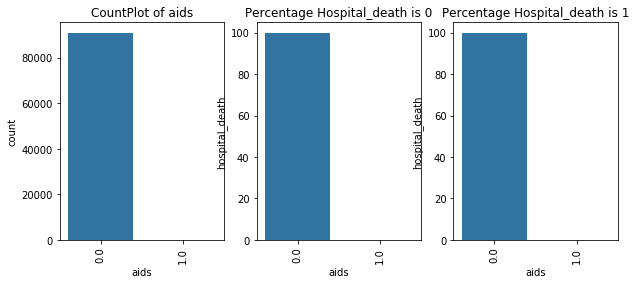

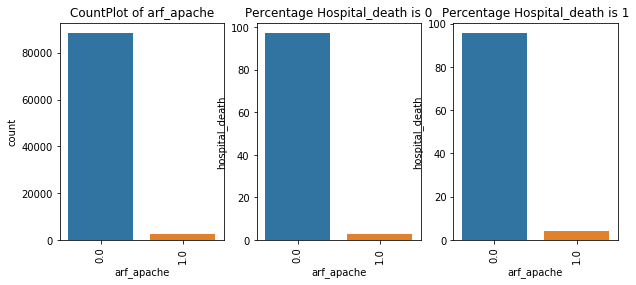

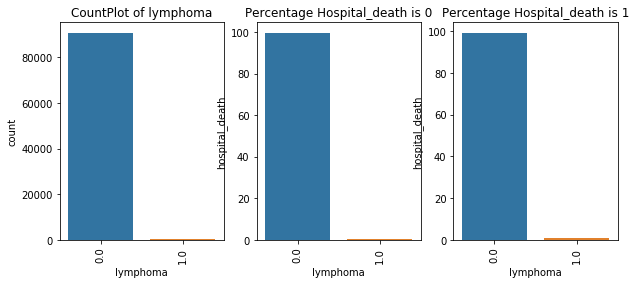

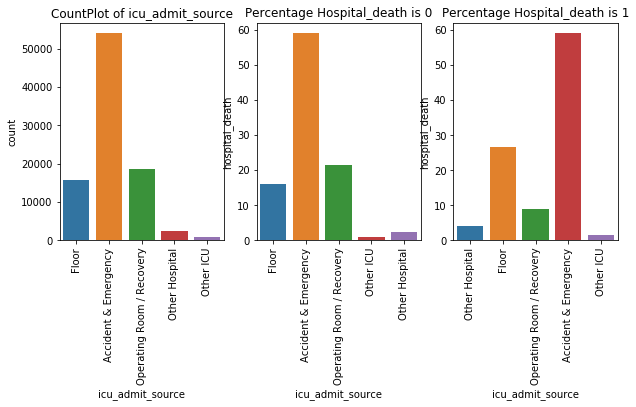

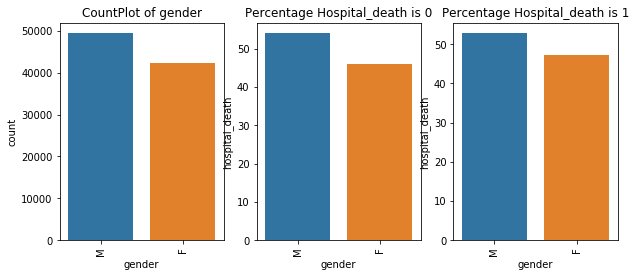

In [14]:
missing_cat_cols_without_min_max = ['hospital_admit_source','gcs_verbal_apache','gcs_motor_apache','gcs_eyes_apache',\
                                'apache_3j_bodysystem','apache_2_bodysystem','apache_2_diagnosis','ethnicity',\
                                'gcs_unable_apache','leukemia','immunosuppression','hepatic_failure',\
                                    'ventilated_apache','diabetes_mellitus','cirrhosis','intubated_apache',\
                                    'aids','arf_apache','lymphoma','icu_admit_source','gender']
for i in missing_cat_cols_without_min_max:
    plot_cat_missing_values_graph(train_features,i)


Numeric columns with missing min and max values

d1_diasbp_invasive_max


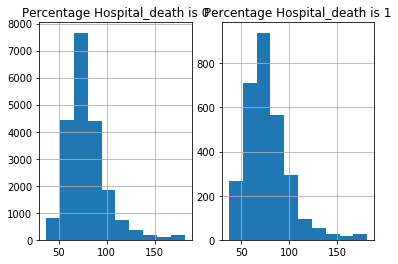

d1_diasbp_invasive_min


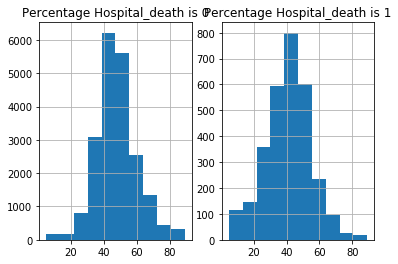

d1_diasbp_max


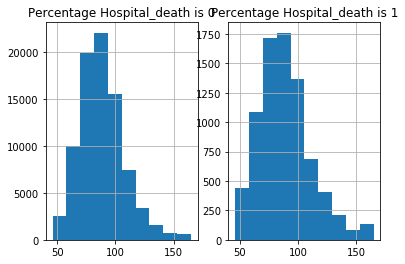

d1_diasbp_min


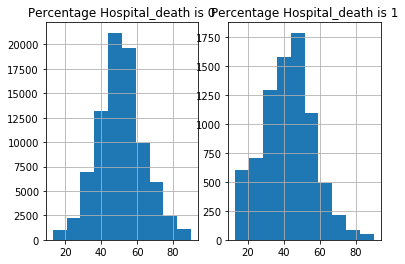

d1_diasbp_noninvasive_max


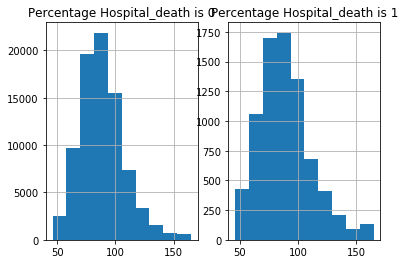

d1_diasbp_noninvasive_min


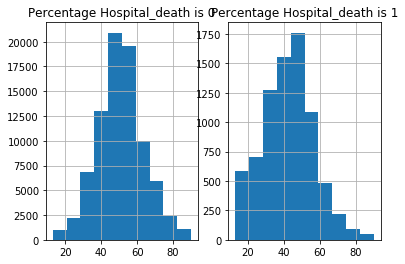

d1_heartrate_max


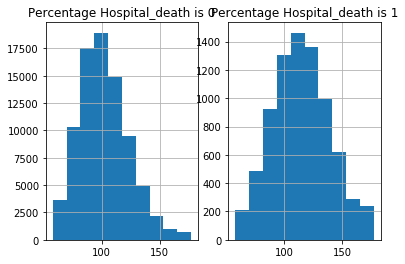

d1_heartrate_min


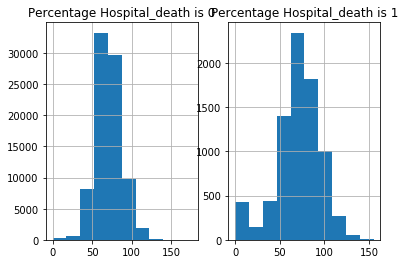

d1_mbp_invasive_max


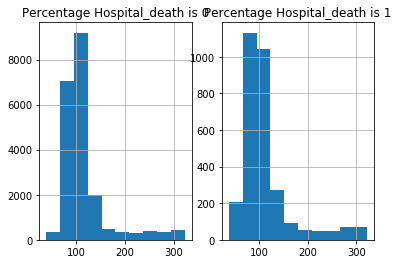

d1_mbp_invasive_min


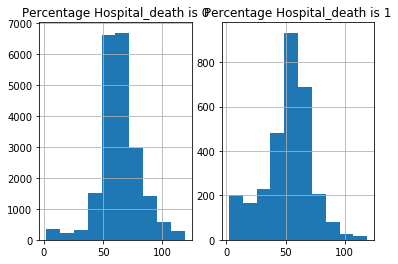

d1_mbp_max


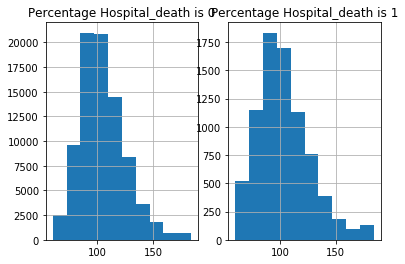

d1_mbp_min


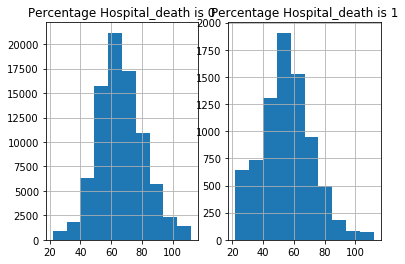

d1_mbp_noninvasive_max


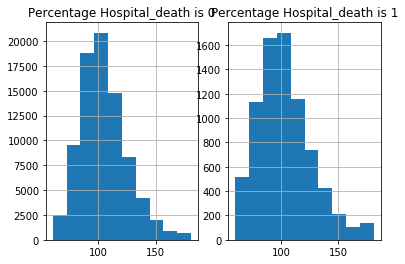

d1_mbp_noninvasive_min


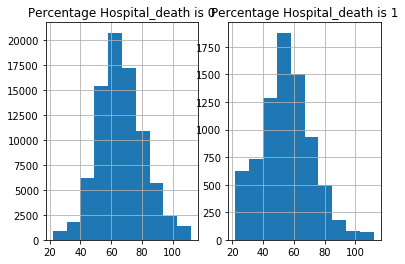

d1_resprate_max


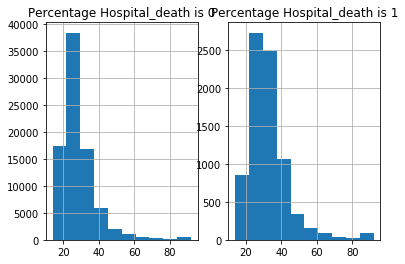

d1_resprate_min


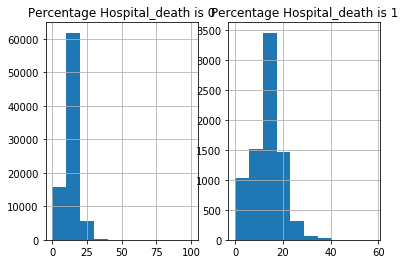

d1_spo2_max


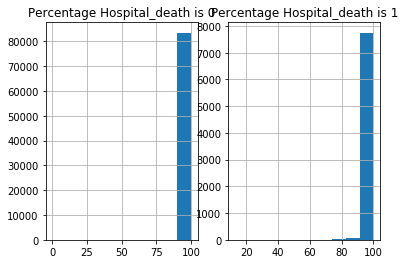

d1_spo2_min


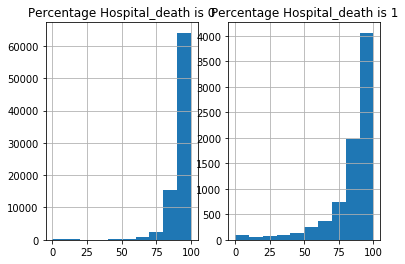

d1_sysbp_invasive_max


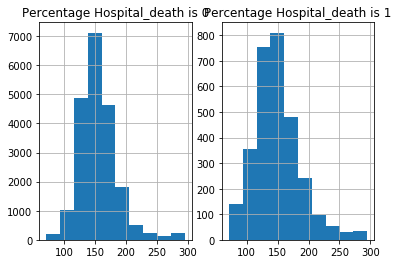

d1_sysbp_invasive_min


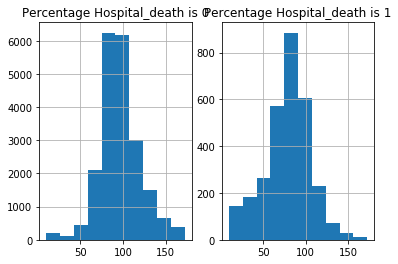

d1_sysbp_max


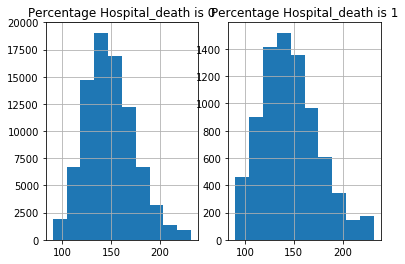

d1_sysbp_min


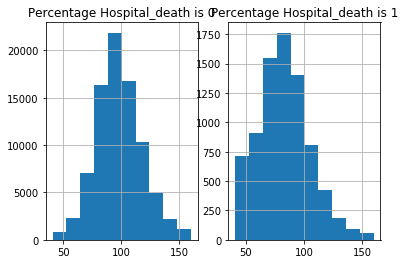

d1_sysbp_noninvasive_max


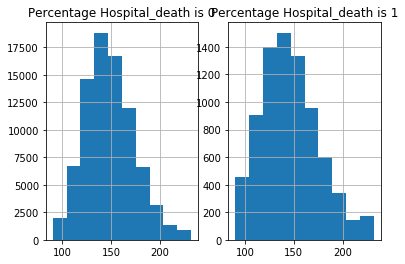

d1_sysbp_noninvasive_min


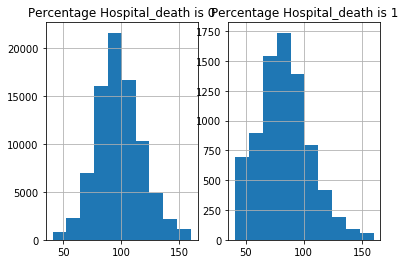

d1_temp_max


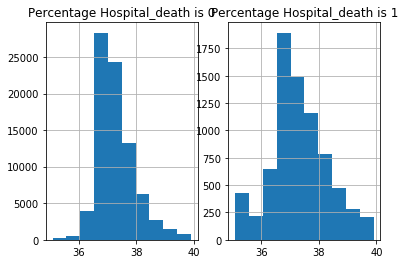

d1_temp_min


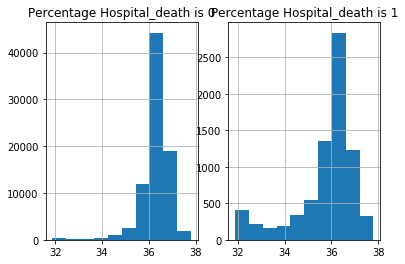

h1_diasbp_invasive_max


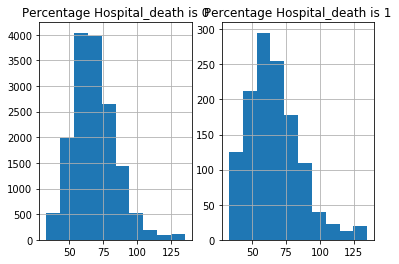

h1_diasbp_invasive_min


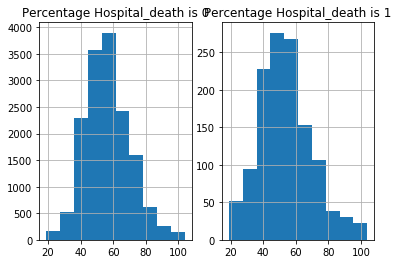

h1_diasbp_max


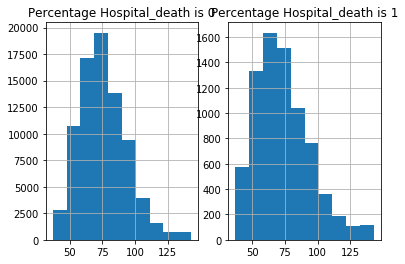

h1_diasbp_min


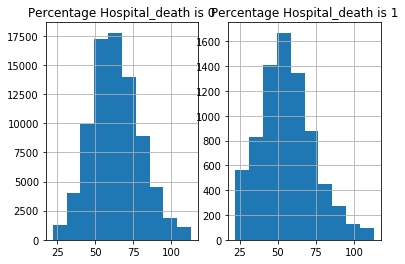

h1_diasbp_noninvasive_max


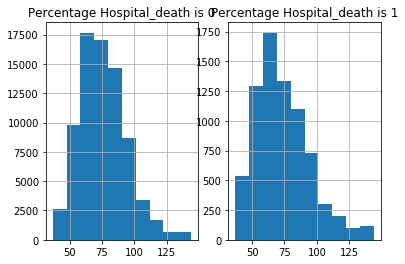

h1_diasbp_noninvasive_min


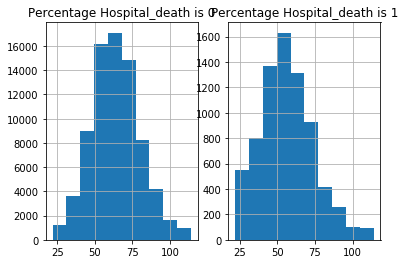

h1_heartrate_max


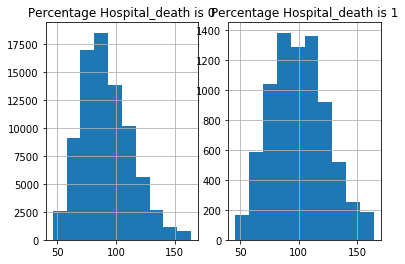

h1_heartrate_min


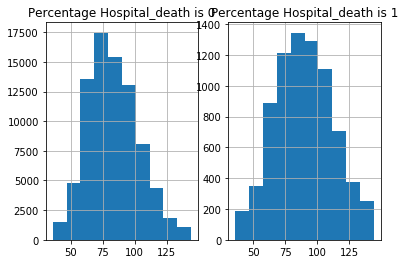

h1_mbp_invasive_max


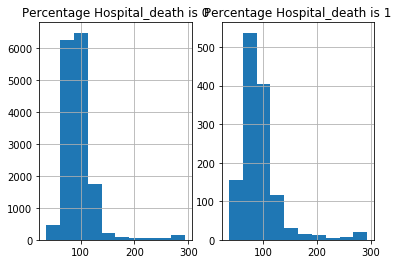

h1_mbp_invasive_min


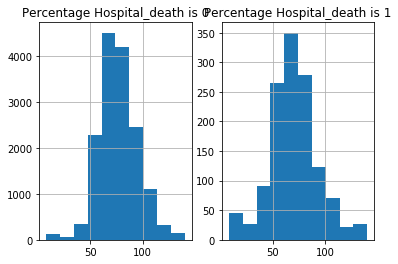

h1_mbp_max


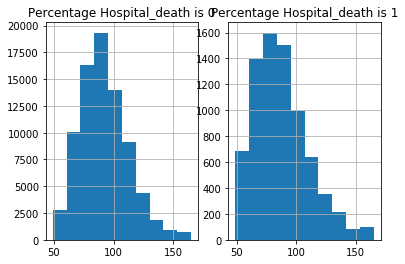

h1_mbp_min


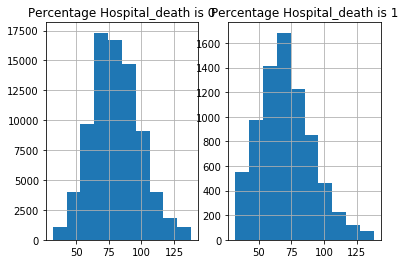

h1_mbp_noninvasive_max


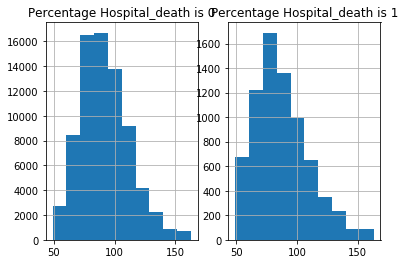

h1_mbp_noninvasive_min


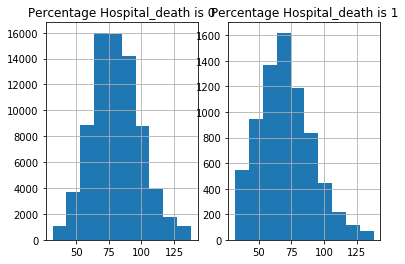

h1_resprate_max


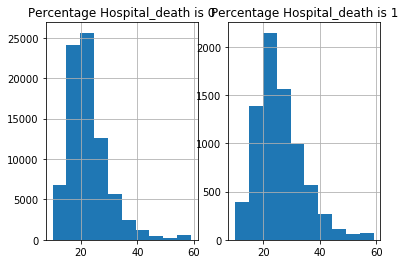

h1_resprate_min


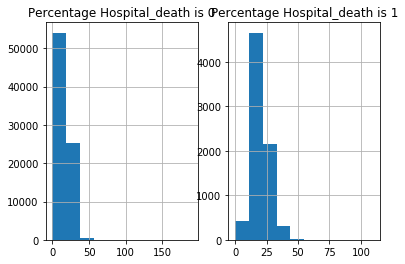

h1_spo2_max


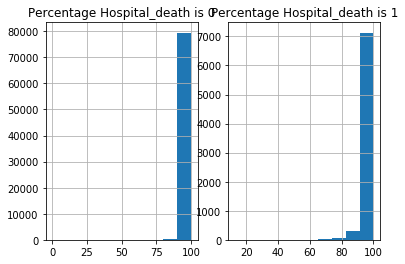

h1_spo2_min


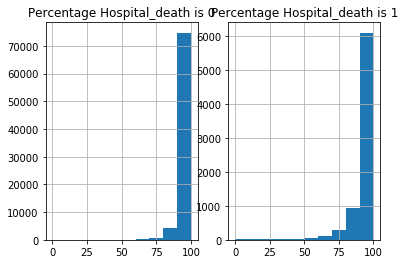

h1_sysbp_invasive_max


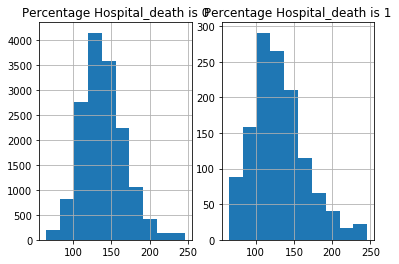

h1_sysbp_invasive_min


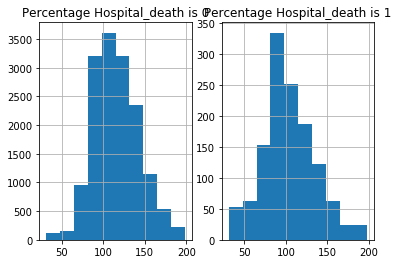

h1_sysbp_max


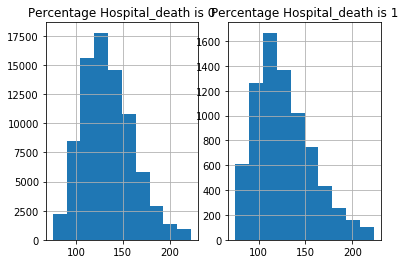

h1_sysbp_min


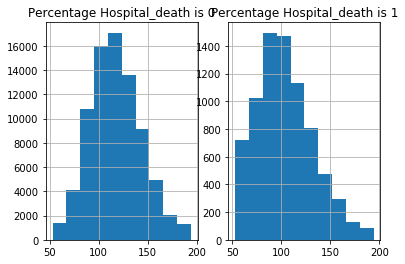

h1_sysbp_noninvasive_max


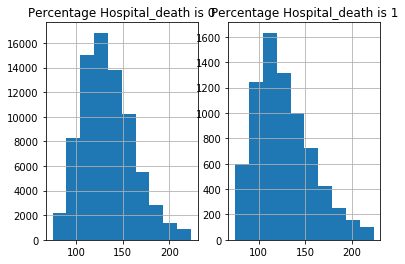

h1_sysbp_noninvasive_min


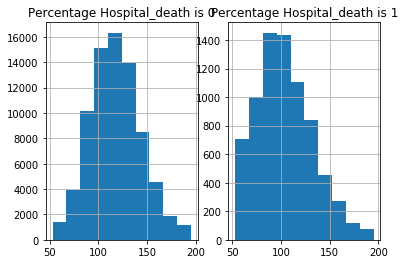

h1_temp_max


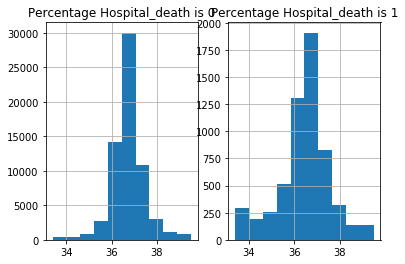

h1_temp_min


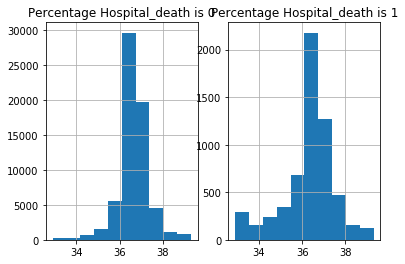

d1_albumin_max


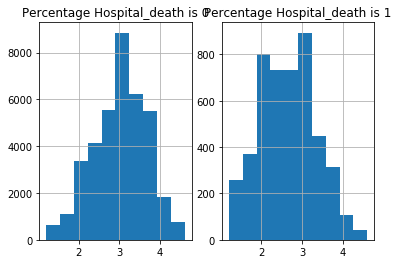

d1_albumin_min


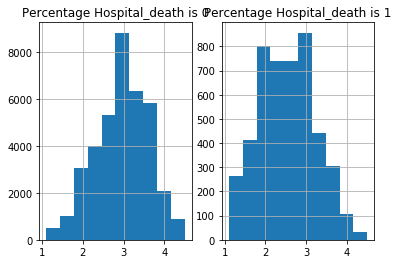

d1_bilirubin_max


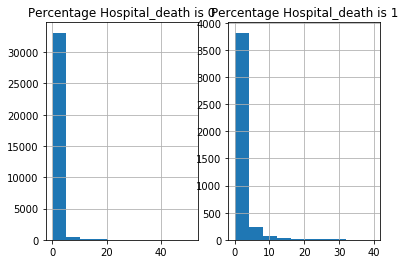

d1_bilirubin_min


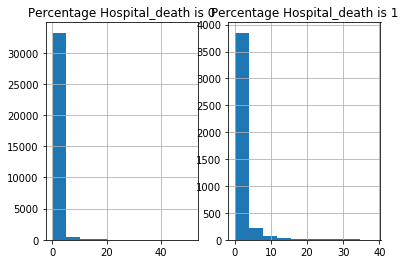

d1_bun_max


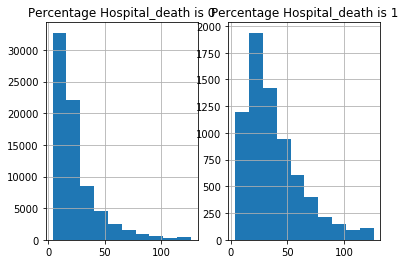

d1_bun_min


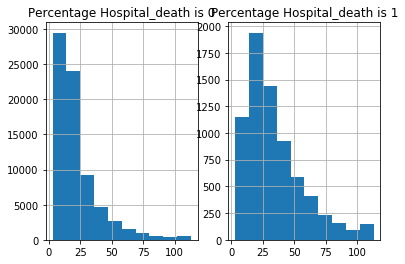

d1_calcium_max


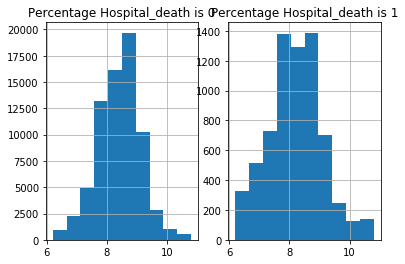

d1_calcium_min


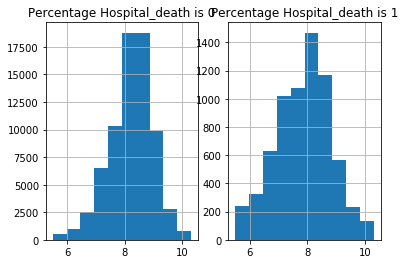

d1_creatinine_max


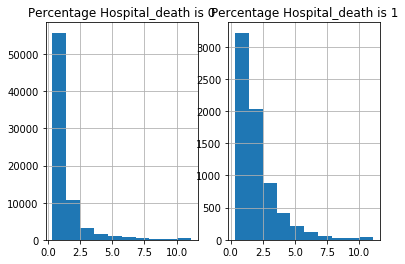

d1_creatinine_min


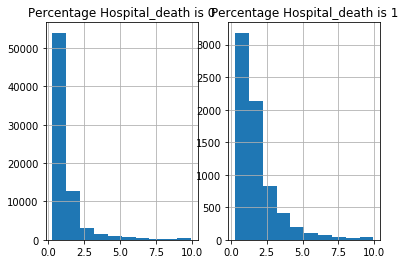

d1_glucose_max


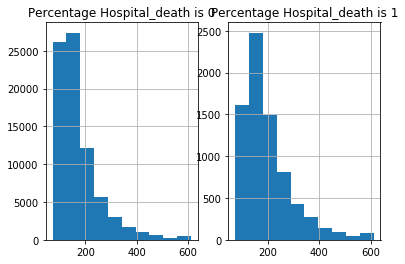

d1_glucose_min


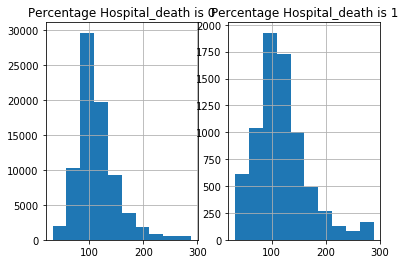

d1_hco3_max


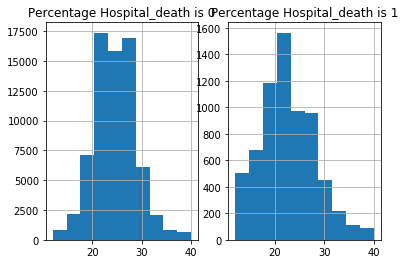

d1_hco3_min


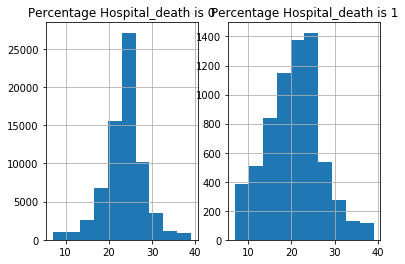

d1_hemaglobin_max


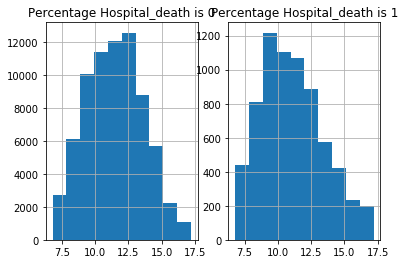

d1_hemaglobin_min


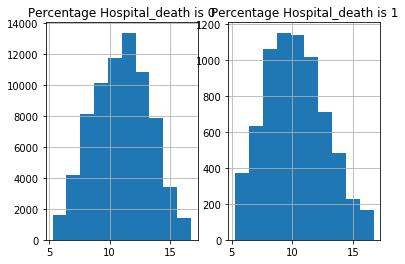

d1_hematocrit_max


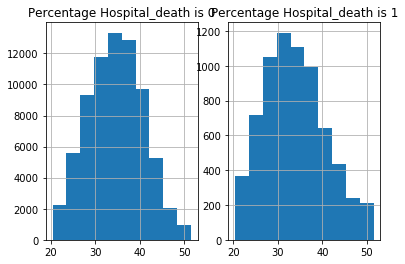

d1_hematocrit_min


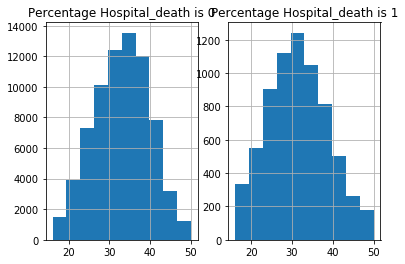

d1_inr_max


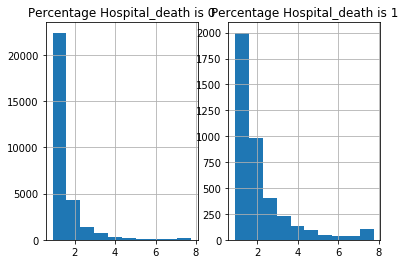

d1_inr_min


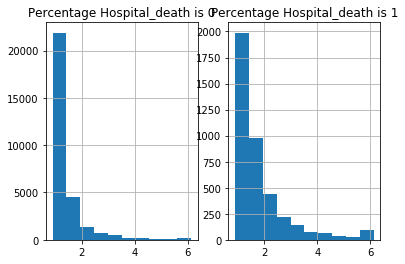

d1_lactate_max


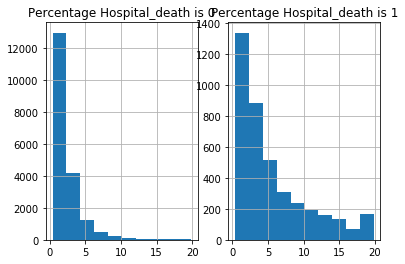

d1_lactate_min


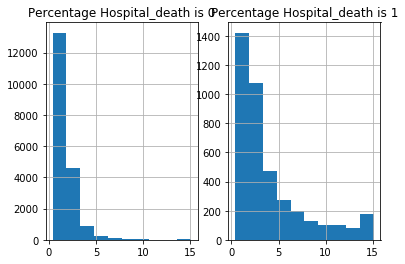

d1_platelets_max


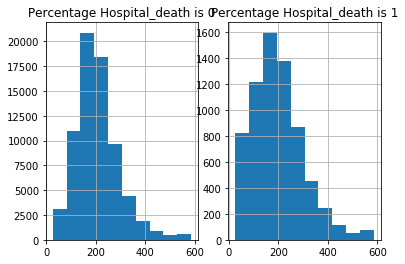

d1_platelets_min


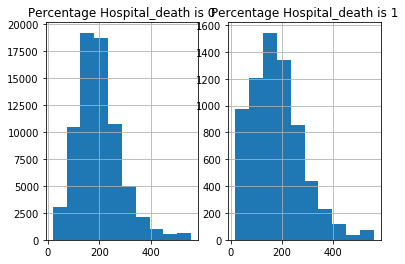

d1_potassium_max


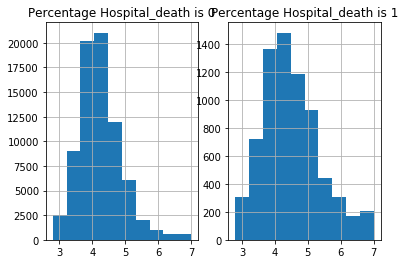

d1_potassium_min


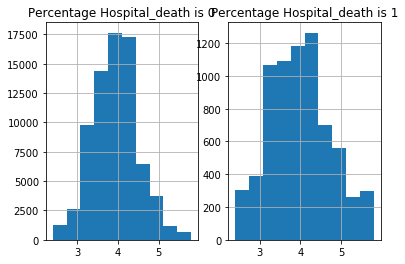

d1_sodium_max


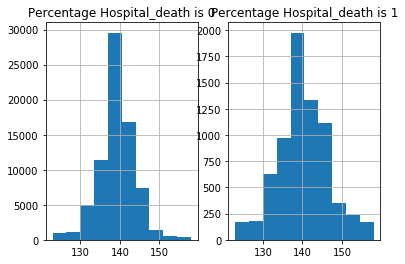

d1_sodium_min


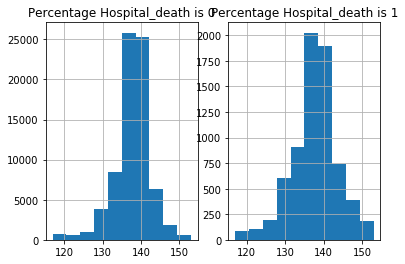

d1_wbc_max


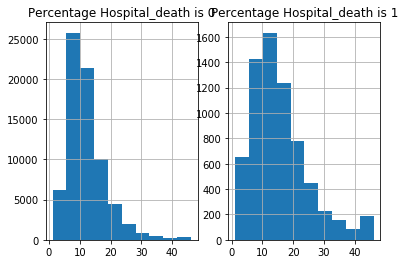

d1_wbc_min


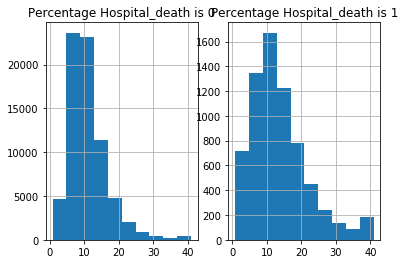

h1_albumin_max


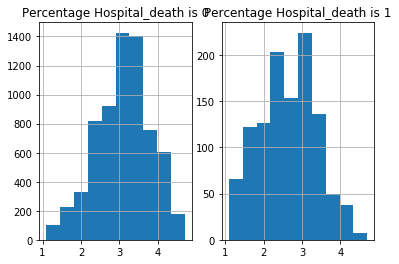

h1_albumin_min


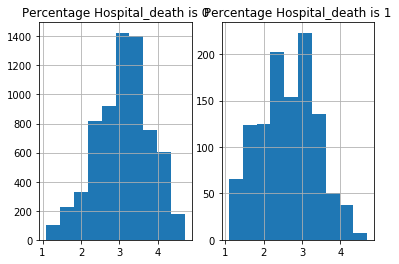

h1_bilirubin_max


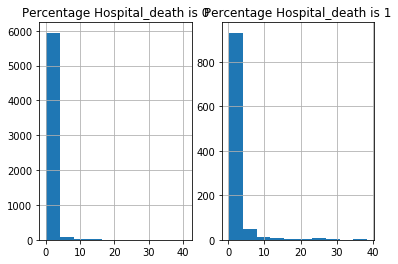

h1_bilirubin_min


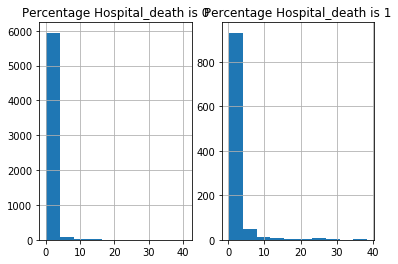

h1_bun_max


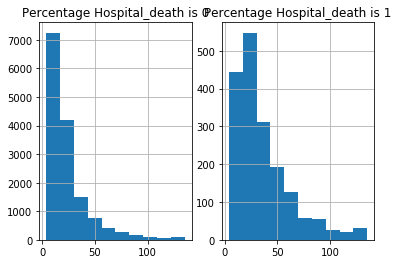

h1_bun_min


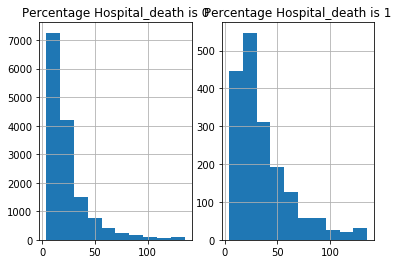

h1_calcium_max


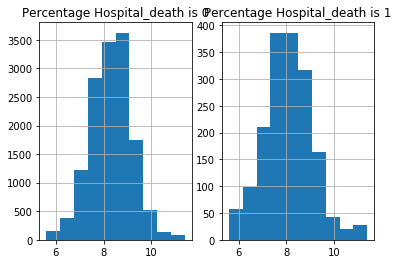

h1_calcium_min


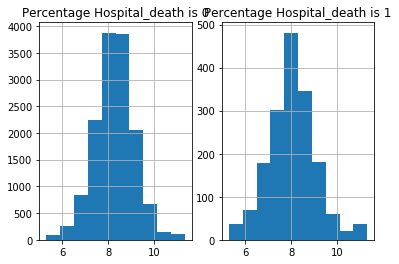

h1_creatinine_max


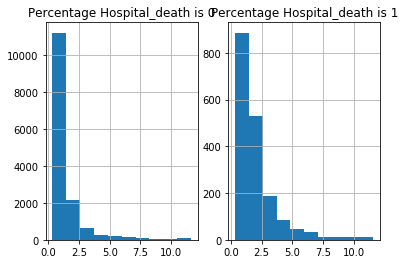

h1_creatinine_min


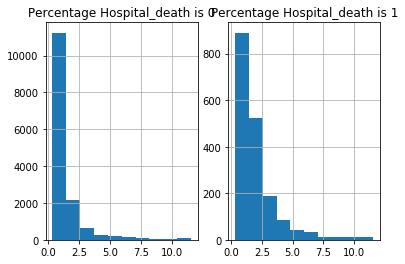

h1_glucose_max


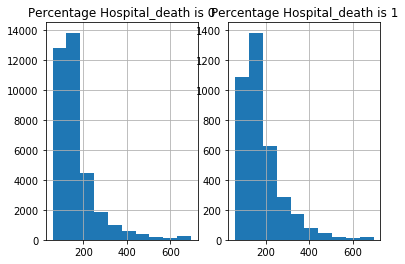

h1_glucose_min


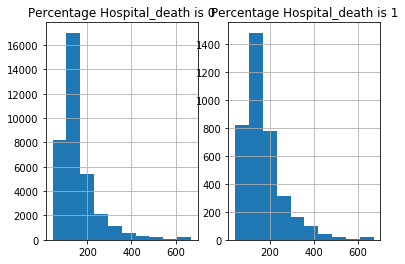

h1_hco3_max


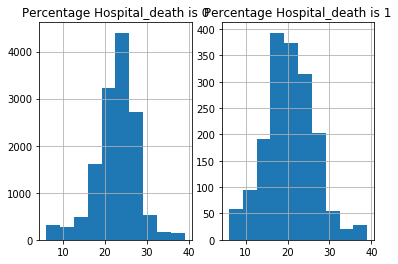

h1_hco3_min


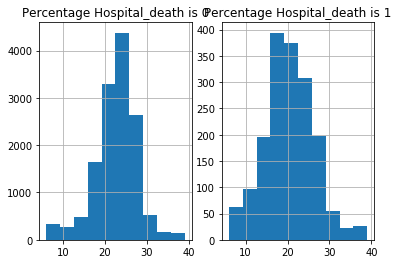

h1_hemaglobin_max


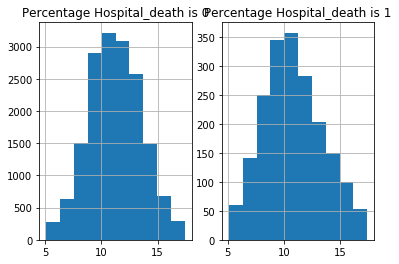

h1_hemaglobin_min


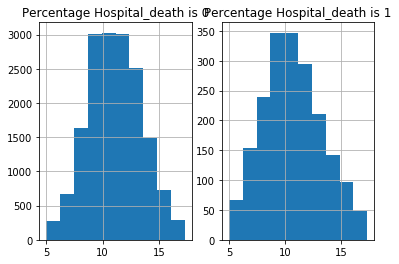

h1_hematocrit_max


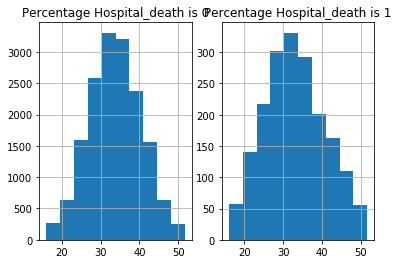

h1_hematocrit_min


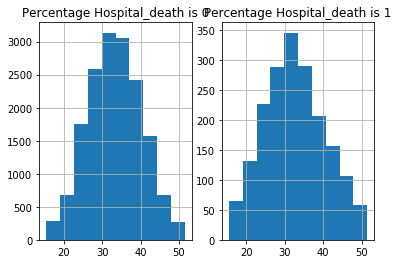

h1_inr_max


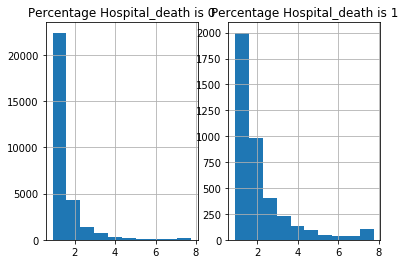

h1_inr_min


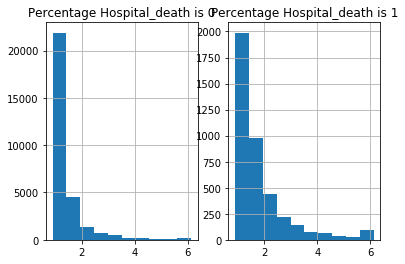

h1_lactate_max


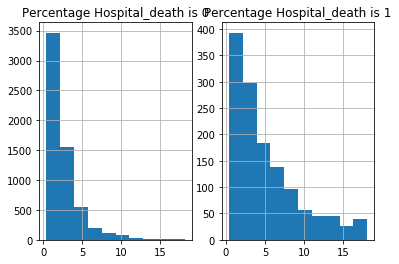

h1_lactate_min


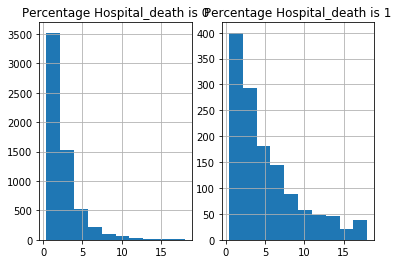

h1_platelets_max


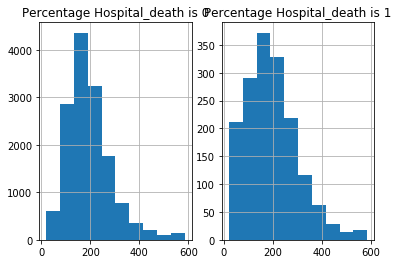

h1_platelets_min


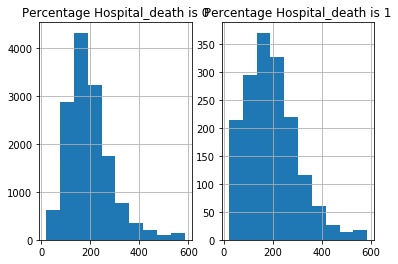

h1_potassium_max


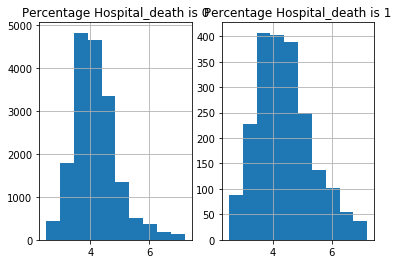

h1_potassium_min


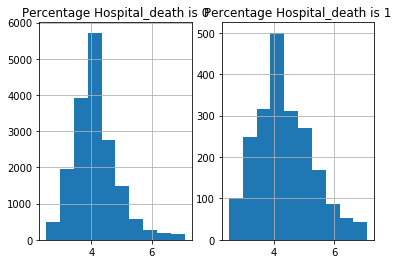

h1_sodium_max


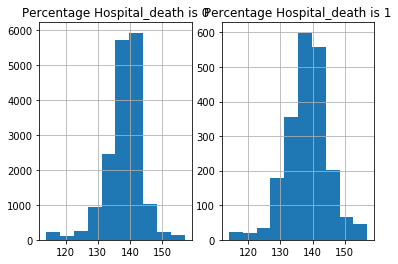

h1_sodium_min


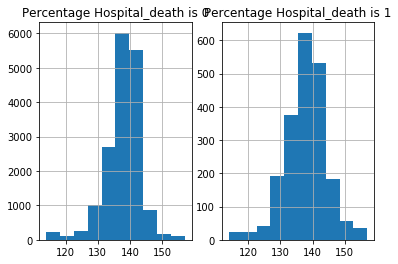

h1_wbc_max


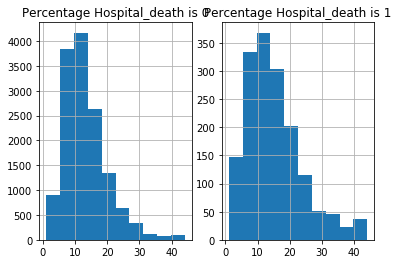

h1_wbc_min


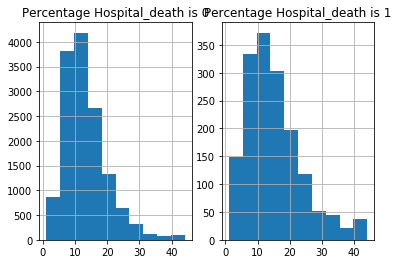

d1_arterial_pco2_max


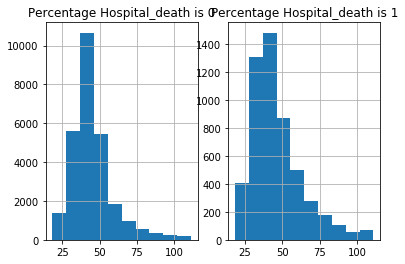

d1_arterial_pco2_min


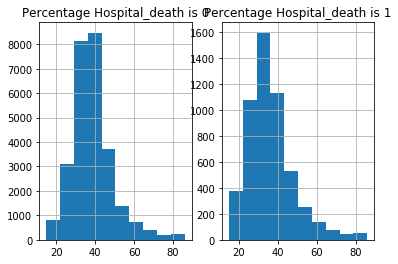

d1_arterial_ph_max


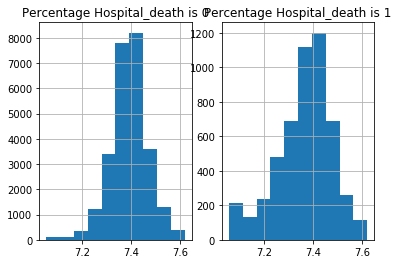

d1_arterial_ph_min


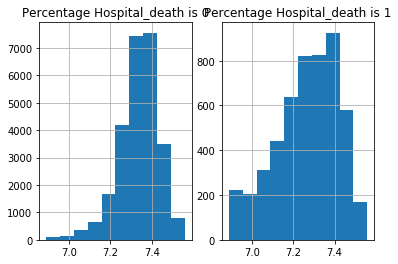

d1_arterial_po2_max


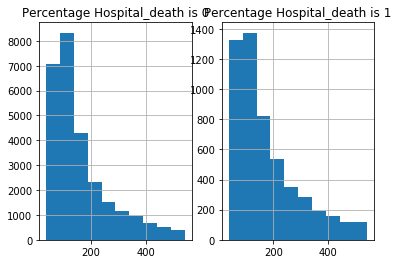

d1_arterial_po2_min


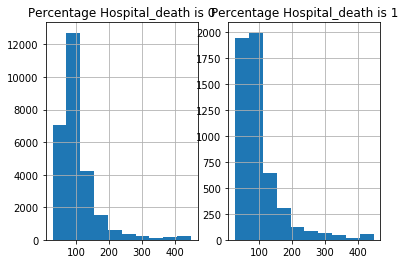

d1_pao2fio2ratio_max


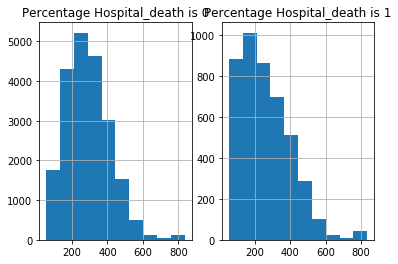

d1_pao2fio2ratio_min


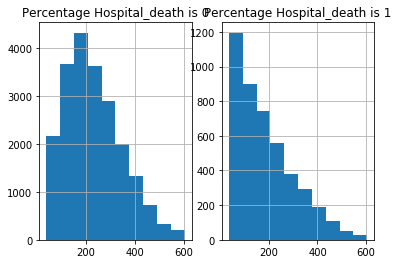

h1_arterial_pco2_max


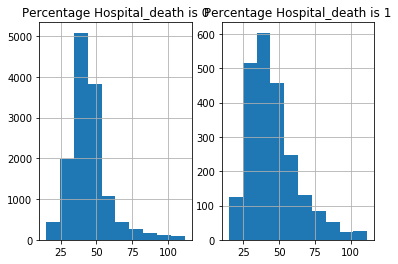

h1_arterial_pco2_min


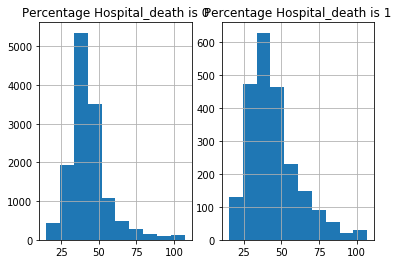

h1_arterial_ph_max


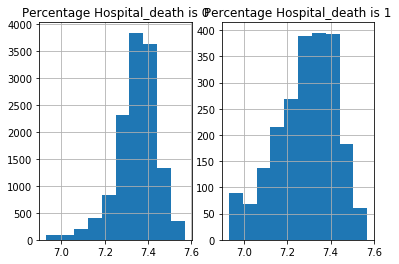

h1_arterial_ph_min


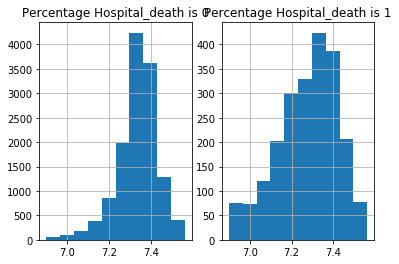

h1_arterial_po2_max


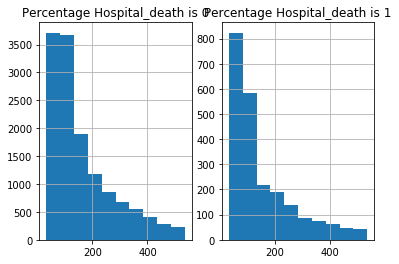

h1_arterial_po2_min


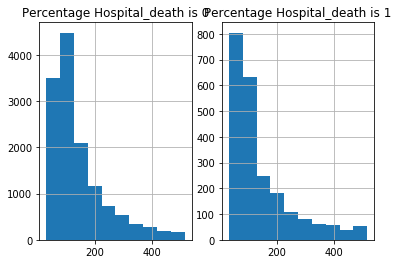

h1_pao2fio2ratio_max


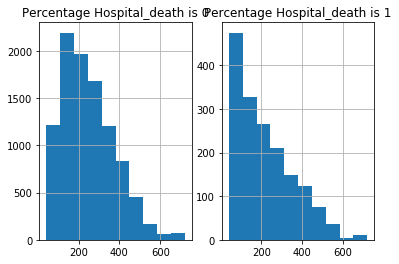

h1_pao2fio2ratio_min


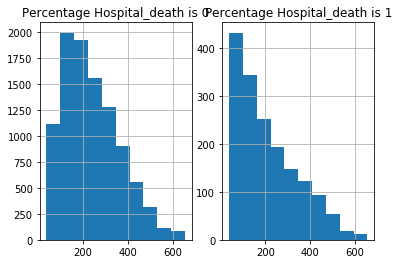

In [15]:
missing_cols_with_min_max=[]
for i in train_features.columns:
    temp = set(i.split('_'))
    if ('min' in temp) or ('max' in temp):
        missing_cols_with_min_max.append(i)
for i in missing_cols_with_min_max:
    print(i)
    plot_missing_values_graph(train_features,i)

Below correlation table: (wip)
1. d1_diasbp_invasive_min - d1_mbp_invasive_min 
2. d1_diasbp_max - d1_diasbp_noninvasive_max,d1_mbp_max,d1_mbp_noninvasive_max
3. d1_diasbp_min - d1_diasbp_noninvasive_min,d1_mbp_min,d1_mbp_noninvasive_min
4. d1_diasbp_noninvasive_max - d1_diasbp_max,d1_mbp_max,d1_mbp_noninvasive_max 
5. d1_diasbp_noninvasive_min - d1_diasbp_min, d1_mbp_min,d1_mbp_noninvasive_min
6. d1_heartrate_max - h1_heartrate_max
7. d1_mbp_invasive_min - d1_diasbp_invasive_min, d1_sysbp_invasive_min
8. d1_mbp_max - d1_diasbp_max,d1_diasbp_noninvasive_max, d1_mbp_noninvasive_max, d1_sysbp_max, d1_sysbp_noninvasive_max
9. d1_mbp_min - d1_diasbp_min, d1_diasbp_noninvasive_min, d1_mbp_noninvasive_min, d1_sysbp_min, d1_sysbp_noninvasive_min
10. d1_mbp_noninvasive_max - d1_diasbp_max, d1_diasbp_noninvasive_max, d1_mbp_max, d1_sysbp_max, d1_sysbp_noninvasive_max
11. d1_mbp_noninvasive_min - d1_diasbp_min, d1_diasbp_noninvasive_min, d1_mbp_min,d1_sysbp_min, d1_sysbp_noninvasive_min
12. d1_sysbp_invasive_min - d1_mbp_invasive_min
13. d1_sysbp_max - d1_mbp_max, d1_mbp_noninvasive_max, d1_sysbp_noninvasive_max, h1_sysbp_max, h1_sysbp_noninvasive_max
14. d1_sysbp_min - d1_mbp_min, d1_mbp_noninvasive_min, d1_sysbp_noninvasive_min
15. d1_sysbp_noninvasive_max - d1_mbp_max, d1_mbp_noninvasive_max, d1_sysbp_max, d1_sysbp_noninvasive_max, h1_sysbp_max, h1_sysbp_noninvasive_max

In [16]:
corr = train_features[missing_cols_with_min_max].corr()
corr.to_excel('correlation_missing_cols_with_min_max.xlsx')
corr.style.background_gradient(cmap='coolwarm')

Below correlation table:
1. paco2_for_ph_apache and paco2_apache highly correlate
2. bun_apache and creatinine_apache highly correlate
3. apache_4a_hospital_death_prob and apache_4a_icu_death_prob highly correlate
4. bmi and weight highly correlate

In [17]:
corr = train_features[missing_num_cols_without_min_max].corr()
corr.style.background_gradient(cmap='coolwarm')

,paco2_for_ph_apache,pao2_apache,ph_apache,paco2_apache,fio2_apache,bilirubin_apache,albumin_apache,urineoutput_apache,wbc_apache,hematocrit_apache,bun_apache,creatinine_apache,sodium_apache,glucose_apache,apache_4a_hospital_death_prob,apache_4a_icu_death_prob,age,bmi,weight,apache_2_diagnosis,height,resprate_apache,apache_3j_diagnosis,map_apache,heart_rate_apache
paco2_for_ph_apache,1,-0.115238,-0.38369,1,0.0919003,-0.117714,0.10307,-0.0037924,-0.0722686,0.173661,-0.0329544,-0.0787706,0.0335815,-0.0400548,-0.0449218,-0.0428948,0.0329995,0.180154,0.174372,-0.0527433,0.0127352,0.00179454,-0.116602,0.00624338,-0.0498899
pao2_apache,-0.115238,1,0.0128046,-0.115238,0.419487,0.00118429,0.00939718,-0.00869043,0.0311705,-0.0784833,-0.0342196,-0.0125781,0.0165325,-0.00309093,0.070376,0.055689,-0.0203002,-0.105925,-0.103107,0.0164589,-0.0111492,-0.0695926,0.0422974,0.022554,0.00605694
ph_apache,-0.38369,0.0128046,1,-0.38369,-0.220608,-0.0267697,0.122269,0.0846619,-0.140869,-0.0266084,-0.178154,-0.182575,-0.00423202,-0.141535,-0.178188,-0.205283,0.0465252,-0.0517234,-0.0517352,0.0722847,-0.00375971,-0.0566428,0.032313,0.0277978,-0.0917916
paco2_apache,1,-0.115238,-0.38369,1,0.0919003,-0.117714,0.10307,-0.0037924,-0.0722686,0.173661,-0.0329544,-0.0787706,0.0335815,-0.0400548,-0.0449218,-0.0428948,0.0329995,0.180154,0.174372,-0.0527433,0.0127352,0.00179454,-0.116602,0.00624338,-0.0498899
fio2_apache,0.0919003,0.419487,-0.220608,0.0919003,1,0.047429,-0.110084,-0.0697111,0.120054,-0.0194449,0.0546677,0.0517261,0.0311489,0.05866,0.246231,0.258017,0.0379347,0.0369608,0.0570241,-0.0740006,0.0477498,0.0625906,-0.0686817,-0.0116807,0.081502
bilirubin_apache,-0.117714,0.00118429,-0.0267697,-0.117714,0.047429,1,-0.139136,-0.0659802,0.0519154,-0.12936,0.105869,0.070756,-0.104257,-0.0519207,0.0885705,0.0865553,-0.0449812,-0.00137185,0.0164375,0.0355188,0.0407433,0.0311262,-0.00239222,-0.0558222,0.0592286
albumin_apache,0.10307,0.00939718,0.122269,0.10307,-0.110084,-0.139136,1,0.133573,-0.162105,0.417014,-0.2154,-0.117418,-0.00384004,-0.0327446,-0.226975,-0.196927,-0.116633,0.0520094,0.0791156,0.0396854,0.0616712,-0.0375707,-0.0857852,0.153773,-0.168265
urineoutput_apache,-0.0037924,-0.00869043,0.0846619,-0.0037924,-0.0697111,-0.0659802,0.133573,1,-0.0389324,0.065984,-0.145557,-0.147847,-0.0363697,0.0367268,-0.135277,-0.103729,-0.176577,0.0549692,0.0870507,0.00289193,0.0809478,-0.0235261,0.0353852,0.0563117,-0.00415036
wbc_apache,-0.0722686,0.0311705,-0.140869,-0.0722686,0.120054,0.0519154,-0.162105,-0.0389324,1,-0.0103769,0.118825,0.0601739,-0.0336762,0.15767,0.131196,0.134592,-0.010786,0.0306839,0.0218453,-0.0302573,-0.0161204,0.063703,0.0945728,-0.0330688,0.164587
hematocrit_apache,0.173661,-0.0784833,-0.0266084,0.173661,-0.0194449,-0.12936,0.417014,0.065984,-0.0103769,1,-0.227658,-0.178815,0.0191389,0.00791532,-0.07771,-0.0687879,-0.118853,0.0976599,0.149615,-0.0494186,0.127095,0.00537111,-0.150827,0.155884,-0.0852746


Fill null values at present by median values for numeric data. This can be worked upon

<b>Preprocess</b>

<b>Bmi</b> - fill missing values using either weight or height or if both weight and height are missing then by overall mean. If weight or height is there then 10% +/- the value is used as range to calcualte the bmi_average

In [18]:
def fill_bmi(data):
    bmi_ = {}
    temp = data[data['bmi'].isnull()==True]['encounter_id'].tolist()
    for i in temp:
        w = data[data['encounter_id']==i]['weight']
        h = data[data['encounter_id']==i]['height']
        if (pd.isna(w.values).all()==True) and (pd.isna(h.values).all()==False):
            lower_value = h.values[0] - (h.values[0]*0.01)
            upper_value = h.values[0] + (h.values[0]*0.01)
            bmi_avg = round(data[(data['height']>=lower_value) & (data['height']<=upper_value)]['bmi'].mean(),3)
            bmi_.update({i:bmi_avg})
        elif (pd.isna(h.values).all()==True) and (pd.isna(w.values).all()==False):
            lower_value = w.values[0] - (w.values[0]*0.01)
            upper_value = w.values[0] + (w.values[0]*0.01)
            bmi_avg = round(data[(data['weight']>=lower_value)&(data['weight']<=upper_value)]['bmi'].mean(),3)
            bmi_.update({i:bmi_avg})
        elif (pd.isna(h.values).all()==True) and (pd.isna(w.values).all()==True):
            bmi_avg = round(data[data['bmi'].isnull()==False]['bmi'].mean(),3)
            bmi_.update({i:bmi_avg})
    return bmi_

In [19]:
train_features.bmi = train_features.bmi.fillna(train_features.encounter_id.map(fill_bmi(train_features)))
test_features.bmi = test_features.bmi.fillna(test_features.encounter_id.map(fill_bmi(test_features)))

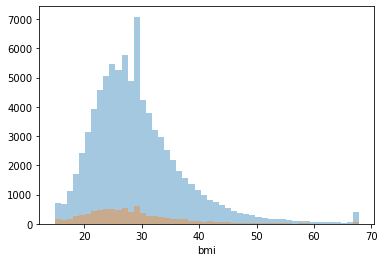

In [21]:
sns.distplot(train_features[train_features['hospital_death']==0].bmi,kde=False)
sns.distplot(train_features[train_features['hospital_death']==1].bmi, kde=False)
plt.show()

For now dropping weight and height columns

In [22]:
train_features = train_features.drop(['weight','height'],axis=1)
test_features = test_features.drop(['weight','height'],axis=1)

Binning bmi to capture more information on overall health base on the range from wikipedia - https://en.wikipedia.org/wiki/Body_mass_index

In [23]:
bin_labels_ = ['Severly_UnderWt', 'UnderWt', 'Normal', 'Overweight', 'Obese']
train_features['bmi_cut'] = pd.cut(train_features['bmi'],
                              bins=[0, 16, 18.5, 25, 35, 100],
                              labels=bin_labels_)
test_features['bmi_cut'] = pd.cut(test_features['bmi'],
                              bins=[0, 16, 18.5, 25, 35, 100],
                              labels=bin_labels_)

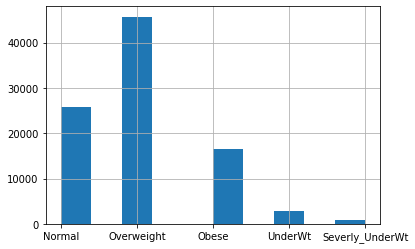

In [24]:
train_features['bmi_cut'].hist()

<b>Numeric columns with missing values without 'min' and 'max' columns</b>                                      

Filling Numeric Column without Min and Max names with median values. This can be worked upon

In [25]:
for i in missing_num_cols_without_min_max:
    if i in train_features.columns:
        train_features.loc[:,i] = train_features.loc[:,i].fillna(train_features[i].median())
        test_features.loc[:,i]=test_features.loc[:,i].fillna(test_features[i].median())

<b> Category columns </b>

Fill Category columns with mode. This can be worked upon

In [26]:
for i in missing_cat_cols_without_min_max:
    x = scipy.stats.mode(train_features[i],axis=None)[0][0]
    train_features.loc[:,i] = train_features.loc[:,i].fillna(x)
    t = scipy.stats.mode(test_features[i],axis=None)[0][0]
    test_features.loc[:,i]=test_features.loc[:,i].fillna(t)

<b>apache_4a_hospital_death_prob and apache_4a_icu_death_prob</b>

'apache_4a_hospital_death_prob' and 'apache_4a_icu_death_prob' are probabilities indicating person death in hospital. There are values which have '-1' hence replacing '-1' with 0 

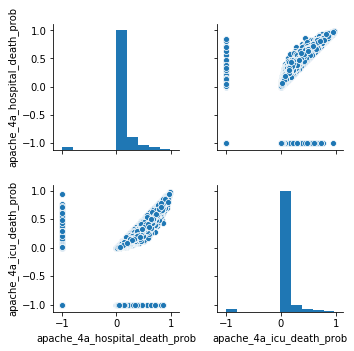

In [27]:
df_ = train_features[['apache_4a_hospital_death_prob','apache_4a_icu_death_prob','hospital_death']]
df_['average_prob'] = train_features['apache_4a_hospital_death_prob']+train_features['apache_4a_icu_death_prob']
df_['average_prob'] = df_['average_prob']/2
sns.pairplot(df_[['apache_4a_hospital_death_prob','apache_4a_icu_death_prob']])
plt.show()

In [28]:
train_features.loc[:,'apache_4a_hospital_death_prob'] = train_features.loc[:,'apache_4a_hospital_death_prob'].apply(lambda x:0 if x<0 else x)
train_features.loc[:,'apache_4a_icu_death_prob'] = train_features.loc[:,'apache_4a_icu_death_prob'].apply(lambda x:0 if x<0 else x)
test_features.loc[:,'apache_4a_hospital_death_prob'] = test_features.loc[:,'apache_4a_hospital_death_prob'].apply(lambda x:0 if x<0 else x)
test_features.loc[:,'apache_4a_icu_death_prob'] = test_features.loc[:,'apache_4a_icu_death_prob'].apply(lambda x:0 if x<0 else x)

Below information yet to be captured

When hospital_death==1, this means that the probabilities should be high or >0.5. For 252 cases this was false

In [29]:
len(df_[(df_['average_prob']<=0)&(df_['hospital_death']==1)])

252

When hospital_death ==0 this means that the probabilities should be less than 0.5. For 1170 cases this was false

In [30]:
len(df_[(df_['average_prob']>0.5)&(df_['hospital_death']==0)])

1170

For now dropping these two columns may work. As they both correlate and they may not give the right direction to hospital death

In [31]:
train_features = train_features.drop(['apache_4a_hospital_death_prob','apache_4a_icu_death_prob'],axis=1)
test_features=test_features.drop(['apache_4a_hospital_death_prob','apache_4a_icu_death_prob'],axis=1)

<b>apache_2_bodysystem and apache_3j_bodysystem</b>

Apace 2 and Apache 3 are scoring to measure severity of disease. Mostly Apache3 has replaced Apache2 but it is still used (https://en.wikipedia.org/wiki/APACHE_II).  73859 rows have same disease identification in both columns while 17854 have different. We can replace values of 'apache_2_bodysystem' column with 'apache_3j_bodysystem' column 

In [32]:
train_features.loc[:,'apache_2_bodysystem'] = train_features.loc[:,'apache_2_bodysystem'].apply(lambda x:'Neurological' if x=='Neurologic' else x)
train_features.loc[:,'apache_2_bodysystem'] = train_features.loc[:,'apache_2_bodysystem'].apply(lambda x:'Genitourinary' if x=='Renal/Genitourinary' else x)
train_features.loc[:,'apache_2_bodysystem'] = train_features.loc[:,'apache_2_bodysystem'].apply(lambda x:'Hematological' if x=='Haematologic' else x)
train_features.loc[:,'apache_2_bodysystem'] = train_features.loc[:,'apache_2_bodysystem'].apply(lambda x:'Undefined diagnoses' if x=='Undefined Diagnoses' else x)
train_features.loc[:,'apache_2_bodysystem'] = np.where(train_features['apache_2_bodysystem']!=train_features['apache_3j_bodysystem'],train_features['apache_3j_bodysystem'],train_features['apache_2_bodysystem'])

test_features.loc[:,'apache_2_bodysystem'] = test_features.loc[:,'apache_2_bodysystem'].apply(lambda x:'Neurological' if x=='Neurologic' else x)
test_features.loc[:,'apache_2_bodysystem'] =test_features.loc[:,'apache_2_bodysystem'].apply(lambda x:'Genitourinary' if x=='Renal/Genitourinary' else x)
test_features.loc[:,'apache_2_bodysystem'] = test_features.loc[:,'apache_2_bodysystem'].apply(lambda x:'Hematological' if x=='Haematologic' else x)
test_features.loc[:,'apache_2_bodysystem'] = test_features.loc[:,'apache_2_bodysystem'].apply(lambda x:'Undefined diagnoses' if x=='Undefined Diagnoses' else x)
test_features.loc[:,'apache_2_bodysystem'] = np.where(test_features['apache_2_bodysystem']!=test_features['apache_3j_bodysystem'],test_features['apache_3j_bodysystem'],test_features['apache_2_bodysystem'])

In [33]:
train_features = train_features.drop(['apache_3j_bodysystem'],axis=1)
test_features=test_features.drop(['apache_3j_bodysystem'],axis=1)

Most common disease is diabetes. Information yet to be captured

In [34]:
var_num_list = list(wids_dic[wids_dic['Data Type']=='numeric']['Variable Name'])
var_num_list.remove('pred')

In [35]:
len(train_features[train_features['aids']==1]),\
len(train_features[train_features['cirrhosis']==1]),\
len(train_features[train_features['diabetes_mellitus']==1]),\
len(train_features[train_features['hepatic_failure']==1]),\
len(train_features[train_features['immunosuppression']==1]),\
len(train_features[train_features['leukemia']==1]),\
len(train_features[train_features['lymphoma']==1]),\
len(train_features[train_features['solid_tumor_with_metastasis']==1])

(78, 1428, 20492, 1182, 2381, 643, 376, 1878)

<b> Age </b>

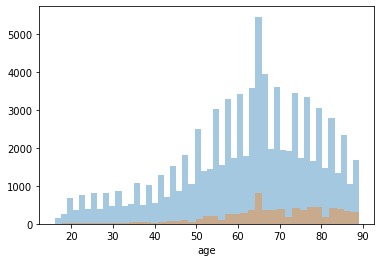

In [36]:
sns.distplot(train_features[train_features['hospital_death']==0].age,kde=False)
sns.distplot(train_features[train_features['hospital_death']==1].age, kde=False)
plt.show()

<b> Gender </b>

In [37]:
train_features['gender'] = train_features['gender'].apply(lambda x:0 if x=='M' else 1)
test_features['gender'] =test_features['gender'].apply(lambda x:0 if x=='M' else 1)

<b> ethnicity, icu_admit_source, hospital_admit_source </b>

In [38]:
train_features = train_features.drop(['ethnicity','icu_admit_source','hospital_admit_source'],axis=1)
test_features = test_features.drop(['ethnicity','icu_admit_source','hospital_admit_source'],axis=1)

<b>apache_2_bodysystem</b>

In [39]:
train_features['Cardiovascular_apache2']=train_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Cardiovascular' else 0)
train_features['Neurological_apache2']=train_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Neurological' else 0)
train_features['Sepsis_apache2']=train_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Sepsis' else 0)
train_features['Respiratory_apache2']=train_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Respiratory' else 0)
train_features['Gastrointestinal_apache2']=train_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Gastrointestinal' else 0)
train_features['Metabolic_apache2']=train_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Metabolic' else 0)
train_features['Trauma_apache2']=train_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Trauma' else 0)
train_features['Genitourinary_apache2']=train_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Genitourinary' else 0)
train_features['Musculoskeletal/Skin_apache2']=train_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Musculoskeletal/Skin' else 0)
train_features['Hematological_apache2']=train_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Hematological' else 0)
train_features['Gynecological_apache2']=train_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Gynecological' else 0)

test_features['Cardiovascular_apache2']=test_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Cardiovascular' else 0)
test_features['Neurological_apache2']=test_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Neurological' else 0)
test_features['Sepsis_apache2']=test_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Sepsis' else 0)
test_features['Respiratory_apache2']=test_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Respiratory' else 0)
test_features['Gastrointestinal_apache2']=test_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Gastrointestinal' else 0)
test_features['Metabolic_apache2']=test_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Metabolic' else 0)
test_features['Trauma_apache2']=test_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Trauma' else 0)
test_features['Genitourinary_apache2']=test_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Genitourinary' else 0)
test_features['Musculoskeletal/Skin_apache2']=test_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Musculoskeletal/Skin' else 0)
test_features['Hematological_apache2']=test_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Hematological' else 0)
test_features['Gynecological_apache2']=test_features['apache_2_bodysystem'].apply(lambda x:1 if x=='Gynecological' else 0)

<b>icu_stay_type</b>

In [40]:
train_features['icu_stay_type']= train_features['icu_stay_type'].apply(lambda x: 1 if x=='admit' else x)
train_features['icu_stay_type']= train_features['icu_stay_type'].apply(lambda x: 2 if x=='transfer' else x)
train_features['icu_stay_type']= train_features['icu_stay_type'].apply(lambda x: 3 if x=='readmit' else x)

test_features['icu_stay_type']= test_features['icu_stay_type'].apply(lambda x: 1 if x=='admit' else x)
test_features['icu_stay_type']= test_features['icu_stay_type'].apply(lambda x: 2 if x=='transfer' else x)
test_features['icu_stay_type']= test_features['icu_stay_type'].apply(lambda x: 3 if x=='readmit' else x)

<b>icu_type</b>

In [41]:
train_features['icu_type'] = train_features['icu_type'].apply(lambda x: 1 if x=='Med-Surg ICU' else x)
train_features['icu_type'] = train_features['icu_type'].apply(lambda x: 2 if x=='CCU-CTICU' else x)
train_features['icu_type'] = train_features['icu_type'].apply(lambda x: 3 if x=='Neuro ICU' else x)
train_features['icu_type'] = train_features['icu_type'].apply(lambda x: 4 if x=='MICU' else x)
train_features['icu_type'] = train_features['icu_type'].apply(lambda x: 5 if x=='CTICU' else x)
train_features['icu_type'] = train_features['icu_type'].apply(lambda x: 6 if x=='CSICU' else x)
train_features['icu_type'] = train_features['icu_type'].apply(lambda x: 7 if x=='Cardiac ICU' else x)
train_features['icu_type'] = train_features['icu_type'].apply(lambda x: 8 if x=='SICU' else x)

test_features['icu_type'] = test_features['icu_type'].apply(lambda x: 1 if x=='Med-Surg ICU' else x)
test_features['icu_type'] = test_features['icu_type'].apply(lambda x: 2 if x=='CCU-CTICU' else x)
test_features['icu_type'] = test_features['icu_type'].apply(lambda x: 3 if x=='Neuro ICU' else x)
test_features['icu_type'] = test_features['icu_type'].apply(lambda x: 4 if x=='MICU' else x)
test_features['icu_type'] = test_features['icu_type'].apply(lambda x: 5 if x=='CTICU' else x)
test_features['icu_type'] = test_features['icu_type'].apply(lambda x: 6 if x=='CSICU' else x)
test_features['icu_type'] = test_features['icu_type'].apply(lambda x: 7 if x=='Cardiac ICU' else x)
test_features['icu_type'] = test_features['icu_type'].apply(lambda x: 8 if x=='SICU' else x)

In [42]:
#for i in X_train.columns:
#    if len(X_train[X_train[i].isnull()==True])>0:
#        X_train[i] = X_train[i].fillna(X_train[i].median())
#for i in X_val.columns:
#    if len(X_val[X_val[i].isnull()==True])>0:
#        X_val[i] = X_val[i].fillna(X_val[i].median())
#for i in test_features.columns:
#    if len(test_features[test_features[i].isnull()==True])>0:
#        test_features[i] = test_features[i].fillna(test_features[i].median())

Dropping columns which have more than or equal to 90% data missing. This needs more work on handling missing data 

In [43]:
col_drop_list = list(missing_df[missing_df['missing_per']>=0.9]['column_name'])
train_features = train_features.drop(col_drop_list,axis=1)
test_features = test_features.drop(col_drop_list,axis=1)

for i in train_features.columns:
    if len(train_features[train_features[i].isnull()==True])>0:
        train_features[i] = train_features[i].fillna(train_features[i].median())
for i in test_features.columns:
    if len(test_features[test_features[i].isnull()==True])>0:
        test_features[i] = test_features[i].fillna(test_features[i].median())

In [44]:
cat_cols = ['icu_stay_type','icu_type','gcs_eyes_apache','gcs_motor_apache',\
            'gcs_unable_apache','gcs_verbal_apache','bmi_cut']

train_features['gcs_eyes_apache']=train_features['gcs_eyes_apache'].astype(int)
train_features['gcs_motor_apache']=train_features['gcs_motor_apache'].astype(int)
train_features['gcs_unable_apache']=train_features['gcs_unable_apache'].astype(int)
train_features['gcs_verbal_apache']=train_features['gcs_verbal_apache'].astype(int)

test_features['gcs_eyes_apache']=test_features['gcs_eyes_apache'].astype(int)
test_features['gcs_motor_apache']=test_features['gcs_motor_apache'].astype(int)
test_features['gcs_unable_apache']=test_features['gcs_unable_apache'].astype(int)
test_features['gcs_verbal_apache']=test_features['gcs_verbal_apache'].astype(int)

In [51]:
train_features = train_features.drop(['apache_2_bodysystem','encounter_id','patient_id','hospital_id','hospital_death','readmission_status','icu_id'],axis=1)#
test_features = test_features.drop(['apache_2_bodysystem','encounter_id','patient_id','hospital_id','hospital_death','readmission_status','icu_id'],axis=1)

### Train model

In [60]:
from sklearn.model_selection import train_test_split

X_train, X_val, y_train, y_val = train_test_split(train_features, train_labels, test_size=0.1, random_state=42)

Oversampling

In [46]:
#sm = SMOTE(random_state=12)

In [47]:
#X_resampled, y_resampled = SMOTE().fit_resample(X_train, y_train)

In [61]:
model = CatBoostClassifier(eval_metric='Accuracy',
                           use_best_model=True,
                           class_weights = [0.9,1],
                           cat_features = cat_cols,
                           random_seed=42)

In [62]:
#model.fit(X_resampled, y_resampled, eval_set=(X_val, y_val))

In [63]:
model.fit(X_train, y_train, eval_set=(X_val, y_val))

Learning rate set to 0.124023
0:	learn: 0.9125774	test: 0.9122178	best: 0.9122178 (0)	total: 119ms	remaining: 1m 58s
1:	learn: 0.9147295	test: 0.9143652	best: 0.9143652 (1)	total: 173ms	remaining: 1m 26s
2:	learn: 0.9154162	test: 0.9149051	best: 0.9149051 (2)	total: 253ms	remaining: 1m 24s
3:	learn: 0.9156015	test: 0.9153010	best: 0.9153010 (3)	total: 318ms	remaining: 1m 19s
4:	learn: 0.9158882	test: 0.9152770	best: 0.9153010 (3)	total: 377ms	remaining: 1m 14s
5:	learn: 0.9165589	test: 0.9151210	best: 0.9153010 (3)	total: 433ms	remaining: 1m 11s
6:	learn: 0.9171282	test: 0.9139213	best: 0.9153010 (3)	total: 503ms	remaining: 1m 11s
7:	learn: 0.9177963	test: 0.9149171	best: 0.9153010 (3)	total: 576ms	remaining: 1m 11s
8:	learn: 0.9182096	test: 0.9156609	best: 0.9156609 (8)	total: 638ms	remaining: 1m 10s
9:	learn: 0.9186256	test: 0.9155769	best: 0.9156609 (8)	total: 694ms	remaining: 1m 8s
10:	learn: 0.9193376	test: 0.9156009	best: 0.9156609 (8)	total: 779ms	remaining: 1m 10s
11:	learn: 0.

94:	learn: 0.9316567	test: 0.9206637	best: 0.9212995 (73)	total: 6.53s	remaining: 1m 2s
95:	learn: 0.9317647	test: 0.9208796	best: 0.9212995 (73)	total: 6.58s	remaining: 1m 1s
96:	learn: 0.9317647	test: 0.9206637	best: 0.9212995 (73)	total: 6.64s	remaining: 1m 1s
97:	learn: 0.9319500	test: 0.9202198	best: 0.9212995 (73)	total: 6.7s	remaining: 1m 1s
98:	learn: 0.9321140	test: 0.9203038	best: 0.9212995 (73)	total: 6.78s	remaining: 1m 1s
99:	learn: 0.9322607	test: 0.9199678	best: 0.9212995 (73)	total: 6.84s	remaining: 1m 1s
100:	learn: 0.9322180	test: 0.9200998	best: 0.9212995 (73)	total: 6.91s	remaining: 1m 1s
101:	learn: 0.9325594	test: 0.9205437	best: 0.9212995 (73)	total: 6.97s	remaining: 1m 1s
102:	learn: 0.9325874	test: 0.9205437	best: 0.9212995 (73)	total: 7.05s	remaining: 1m 1s
103:	learn: 0.9328220	test: 0.9200878	best: 0.9212995 (73)	total: 7.11s	remaining: 1m 1s
104:	learn: 0.9326940	test: 0.9196439	best: 0.9212995 (73)	total: 7.18s	remaining: 1m 1s
105:	learn: 0.9328434	test: 

189:	learn: 0.9402049	test: 0.9220553	best: 0.9223792 (180)	total: 13s	remaining: 55.5s
190:	learn: 0.9403236	test: 0.9221753	best: 0.9223792 (180)	total: 13.1s	remaining: 55.4s
191:	learn: 0.9402742	test: 0.9221633	best: 0.9223792 (180)	total: 13.1s	remaining: 55.3s
192:	learn: 0.9402396	test: 0.9224152	best: 0.9224152 (192)	total: 13.2s	remaining: 55.2s
193:	learn: 0.9403822	test: 0.9223073	best: 0.9224152 (192)	total: 13.3s	remaining: 55.2s
194:	learn: 0.9403849	test: 0.9221753	best: 0.9224152 (192)	total: 13.3s	remaining: 55.1s
195:	learn: 0.9403876	test: 0.9224152	best: 0.9224152 (192)	total: 13.4s	remaining: 55.1s
196:	learn: 0.9404676	test: 0.9226552	best: 0.9226552 (196)	total: 13.5s	remaining: 55.1s
197:	learn: 0.9405556	test: 0.9226552	best: 0.9226552 (196)	total: 13.6s	remaining: 55.2s
198:	learn: 0.9405663	test: 0.9224032	best: 0.9226552 (196)	total: 13.7s	remaining: 55.2s
199:	learn: 0.9406476	test: 0.9223193	best: 0.9226552 (196)	total: 13.8s	remaining: 55.1s
200:	learn: 

281:	learn: 0.9459704	test: 0.9223792	best: 0.9232310 (223)	total: 19.4s	remaining: 49.5s
282:	learn: 0.9460477	test: 0.9224992	best: 0.9232310 (223)	total: 19.5s	remaining: 49.4s
283:	learn: 0.9461371	test: 0.9224872	best: 0.9232310 (223)	total: 19.6s	remaining: 49.3s
284:	learn: 0.9461864	test: 0.9226072	best: 0.9232310 (223)	total: 19.6s	remaining: 49.2s
285:	learn: 0.9462811	test: 0.9226072	best: 0.9232310 (223)	total: 19.7s	remaining: 49.2s
286:	learn: 0.9463718	test: 0.9226072	best: 0.9232310 (223)	total: 19.8s	remaining: 49.1s
287:	learn: 0.9464078	test: 0.9228351	best: 0.9232310 (223)	total: 19.8s	remaining: 49s
288:	learn: 0.9464091	test: 0.9226192	best: 0.9232310 (223)	total: 19.9s	remaining: 48.9s
289:	learn: 0.9464918	test: 0.9225112	best: 0.9232310 (223)	total: 19.9s	remaining: 48.8s
290:	learn: 0.9466704	test: 0.9222833	best: 0.9232310 (223)	total: 20s	remaining: 48.7s
291:	learn: 0.9466878	test: 0.9223673	best: 0.9232310 (223)	total: 20s	remaining: 48.6s
292:	learn: 0.94

373:	learn: 0.9507786	test: 0.9224512	best: 0.9232310 (223)	total: 25s	remaining: 41.9s
374:	learn: 0.9508652	test: 0.9226792	best: 0.9232310 (223)	total: 25.1s	remaining: 41.8s
375:	learn: 0.9509146	test: 0.9224392	best: 0.9232310 (223)	total: 25.1s	remaining: 41.7s
376:	learn: 0.9509639	test: 0.9226672	best: 0.9232310 (223)	total: 25.2s	remaining: 41.6s
377:	learn: 0.9510012	test: 0.9227871	best: 0.9232310 (223)	total: 25.3s	remaining: 41.6s
378:	learn: 0.9510186	test: 0.9226792	best: 0.9232310 (223)	total: 25.3s	remaining: 41.5s
379:	learn: 0.9510586	test: 0.9226792	best: 0.9232310 (223)	total: 25.4s	remaining: 41.4s
380:	learn: 0.9510426	test: 0.9224632	best: 0.9232310 (223)	total: 25.4s	remaining: 41.3s
381:	learn: 0.9510812	test: 0.9225832	best: 0.9232310 (223)	total: 25.5s	remaining: 41.3s
382:	learn: 0.9511146	test: 0.9227032	best: 0.9232310 (223)	total: 25.6s	remaining: 41.2s
383:	learn: 0.9511052	test: 0.9225832	best: 0.9232310 (223)	total: 25.6s	remaining: 41.1s
384:	learn: 

465:	learn: 0.9551960	test: 0.9228471	best: 0.9232310 (223)	total: 30.6s	remaining: 35s
466:	learn: 0.9552600	test: 0.9231830	best: 0.9232310 (223)	total: 30.6s	remaining: 34.9s
467:	learn: 0.9552947	test: 0.9230631	best: 0.9232310 (223)	total: 30.7s	remaining: 34.9s
468:	learn: 0.9553214	test: 0.9231830	best: 0.9232310 (223)	total: 30.7s	remaining: 34.8s
469:	learn: 0.9553334	test: 0.9231830	best: 0.9232310 (223)	total: 30.8s	remaining: 34.7s
470:	learn: 0.9553347	test: 0.9232910	best: 0.9232910 (470)	total: 30.9s	remaining: 34.7s
471:	learn: 0.9553467	test: 0.9232910	best: 0.9232910 (470)	total: 30.9s	remaining: 34.6s
472:	learn: 0.9554347	test: 0.9232910	best: 0.9232910 (470)	total: 31s	remaining: 34.5s
473:	learn: 0.9554907	test: 0.9231830	best: 0.9232910 (470)	total: 31s	remaining: 34.4s
474:	learn: 0.9555307	test: 0.9230751	best: 0.9232910 (470)	total: 31.1s	remaining: 34.4s
475:	learn: 0.9556200	test: 0.9229671	best: 0.9232910 (470)	total: 31.1s	remaining: 34.3s
476:	learn: 0.95

560:	learn: 0.9590535	test: 0.9216234	best: 0.9232910 (470)	total: 36.3s	remaining: 28.4s
561:	learn: 0.9589255	test: 0.9218394	best: 0.9232910 (470)	total: 36.4s	remaining: 28.4s
562:	learn: 0.9589388	test: 0.9220553	best: 0.9232910 (470)	total: 36.4s	remaining: 28.3s
563:	learn: 0.9589788	test: 0.9220553	best: 0.9232910 (470)	total: 36.5s	remaining: 28.2s
564:	learn: 0.9590308	test: 0.9219474	best: 0.9232910 (470)	total: 36.6s	remaining: 28.2s
565:	learn: 0.9590455	test: 0.9219474	best: 0.9232910 (470)	total: 36.6s	remaining: 28.1s
566:	learn: 0.9591161	test: 0.9215035	best: 0.9232910 (470)	total: 36.7s	remaining: 28s
567:	learn: 0.9591935	test: 0.9216114	best: 0.9232910 (470)	total: 36.7s	remaining: 27.9s
568:	learn: 0.9591815	test: 0.9216114	best: 0.9232910 (470)	total: 36.8s	remaining: 27.9s
569:	learn: 0.9593601	test: 0.9219354	best: 0.9232910 (470)	total: 36.9s	remaining: 27.8s
570:	learn: 0.9593455	test: 0.9218274	best: 0.9232910 (470)	total: 36.9s	remaining: 27.7s
571:	learn: 

652:	learn: 0.9620096	test: 0.9218634	best: 0.9232910 (470)	total: 41.9s	remaining: 22.3s
653:	learn: 0.9619842	test: 0.9215275	best: 0.9232910 (470)	total: 41.9s	remaining: 22.2s
654:	learn: 0.9619722	test: 0.9215395	best: 0.9232910 (470)	total: 42s	remaining: 22.1s
655:	learn: 0.9619709	test: 0.9217674	best: 0.9232910 (470)	total: 42s	remaining: 22s
656:	learn: 0.9619976	test: 0.9218754	best: 0.9232910 (470)	total: 42.1s	remaining: 22s
657:	learn: 0.9620376	test: 0.9217554	best: 0.9232910 (470)	total: 42.2s	remaining: 21.9s
658:	learn: 0.9621309	test: 0.9216474	best: 0.9232910 (470)	total: 42.2s	remaining: 21.8s
659:	learn: 0.9621042	test: 0.9218634	best: 0.9232910 (470)	total: 42.3s	remaining: 21.8s
660:	learn: 0.9621309	test: 0.9219833	best: 0.9232910 (470)	total: 42.3s	remaining: 21.7s
661:	learn: 0.9621602	test: 0.9221153	best: 0.9232910 (470)	total: 42.4s	remaining: 21.6s
662:	learn: 0.9622109	test: 0.9220073	best: 0.9232910 (470)	total: 42.5s	remaining: 21.6s
663:	learn: 0.9621

744:	learn: 0.9646536	test: 0.9219474	best: 0.9232910 (470)	total: 47.4s	remaining: 16.2s
745:	learn: 0.9646403	test: 0.9220673	best: 0.9232910 (470)	total: 47.4s	remaining: 16.2s
746:	learn: 0.9647323	test: 0.9221873	best: 0.9232910 (470)	total: 47.5s	remaining: 16.1s
747:	learn: 0.9647056	test: 0.9220793	best: 0.9232910 (470)	total: 47.6s	remaining: 16s
748:	learn: 0.9647336	test: 0.9221753	best: 0.9232910 (470)	total: 47.6s	remaining: 16s
749:	learn: 0.9647456	test: 0.9219354	best: 0.9232910 (470)	total: 47.7s	remaining: 15.9s
750:	learn: 0.9647843	test: 0.9219234	best: 0.9232910 (470)	total: 47.7s	remaining: 15.8s
751:	learn: 0.9648110	test: 0.9220433	best: 0.9232910 (470)	total: 47.8s	remaining: 15.8s
752:	learn: 0.9647976	test: 0.9217914	best: 0.9232910 (470)	total: 47.9s	remaining: 15.7s
753:	learn: 0.9649256	test: 0.9215754	best: 0.9232910 (470)	total: 47.9s	remaining: 15.6s
754:	learn: 0.9649790	test: 0.9215754	best: 0.9232910 (470)	total: 48s	remaining: 15.6s
755:	learn: 0.96

836:	learn: 0.9671924	test: 0.9209036	best: 0.9232910 (470)	total: 52.9s	remaining: 10.3s
837:	learn: 0.9671910	test: 0.9209036	best: 0.9232910 (470)	total: 53s	remaining: 10.2s
838:	learn: 0.9672057	test: 0.9208916	best: 0.9232910 (470)	total: 53s	remaining: 10.2s
839:	learn: 0.9672190	test: 0.9207716	best: 0.9232910 (470)	total: 53.1s	remaining: 10.1s
840:	learn: 0.9672337	test: 0.9206637	best: 0.9232910 (470)	total: 53.2s	remaining: 10.1s
841:	learn: 0.9672710	test: 0.9208796	best: 0.9232910 (470)	total: 53.2s	remaining: 9.98s
842:	learn: 0.9672724	test: 0.9209996	best: 0.9232910 (470)	total: 53.3s	remaining: 9.92s
843:	learn: 0.9673124	test: 0.9209996	best: 0.9232910 (470)	total: 53.3s	remaining: 9.86s
844:	learn: 0.9673537	test: 0.9211196	best: 0.9232910 (470)	total: 53.4s	remaining: 9.79s
845:	learn: 0.9673537	test: 0.9211196	best: 0.9232910 (470)	total: 53.5s	remaining: 9.73s
846:	learn: 0.9673390	test: 0.9211316	best: 0.9232910 (470)	total: 53.5s	remaining: 9.67s
847:	learn: 0.

928:	learn: 0.9694378	test: 0.9213835	best: 0.9232910 (470)	total: 58.5s	remaining: 4.47s
929:	learn: 0.9694258	test: 0.9214915	best: 0.9232910 (470)	total: 58.5s	remaining: 4.41s
930:	learn: 0.9695044	test: 0.9214915	best: 0.9232910 (470)	total: 58.6s	remaining: 4.34s
931:	learn: 0.9694644	test: 0.9213835	best: 0.9232910 (470)	total: 58.7s	remaining: 4.28s
932:	learn: 0.9694511	test: 0.9212635	best: 0.9232910 (470)	total: 58.7s	remaining: 4.22s
933:	learn: 0.9694791	test: 0.9212635	best: 0.9232910 (470)	total: 58.8s	remaining: 4.15s
934:	learn: 0.9695578	test: 0.9213835	best: 0.9232910 (470)	total: 58.8s	remaining: 4.09s
935:	learn: 0.9695844	test: 0.9215035	best: 0.9232910 (470)	total: 58.9s	remaining: 4.03s
936:	learn: 0.9695578	test: 0.9212755	best: 0.9232910 (470)	total: 59s	remaining: 3.96s
937:	learn: 0.9695564	test: 0.9215155	best: 0.9232910 (470)	total: 59s	remaining: 3.9s
938:	learn: 0.9696084	test: 0.9215155	best: 0.9232910 (470)	total: 59.1s	remaining: 3.84s
939:	learn: 0.9

### Make predictions

In [64]:
def make_submission(preds):
    df = pd.read_csv('solution_template.csv', usecols=['encounter_id'])
    df['hospital_death'] = preds
    timestamp = '{:%y%m%d_%H%M}'.format(datetime.now())
    df.to_csv(f'solution_{timestamp}.csv', index=False)

In [66]:
preds = model.predict_proba(test_features)[:,1]

In [67]:
make_submission(preds)

https://www.kaggle.com/c/widsdatathon2020/submit

Score 1 - with no oversampling only basic processing (filling with non min and max columns with median values) and applying catboost - 0.90073

Score 2 - with no oversampling and when 'min' and 'max' columns are filled with median and apply catboost -  0.89918

Score 3 - with no oversampling, dropping 70% or more  'min' and 'max' value column dropped and rest filled with median  value and apply catboost - 0.89611

Score 4 - with oversampling, dropping 70% or more 'min' and 'max' value column dropped and rest filled with median value and apply catboost - 0.88914

Score 5 - with oversampling, filling 'min' and 'max' value column with median and apply catboos - 0.89590

Score 6- date Feb3 - with no oversampling, class weight=[0.9,1], filling non median values for min and max, bmi calculated and binned, dropping columns with 90%missing values, fillign rest with median values, using catboost - 0.90338 (solution_200204_0015.csv)

Score7- date Feb 4 - with no oversampling, keeping the rest of stuff as it is, dividing into two age groups dropped the score to 0.49856 (a bug I guess or overfitting)